# Besample Externship 2024


# Bot Detection for Accurate Survey Results

## Description

"Besample is a new tool designed to empower human-focused scientists to study participants beyond Western, educated, industrialized, rich, democratic (WEIRD) populations. Ninety-six percent of research studies only use American or European participants, which does not accurately represent the diversity of humanity. Besample provides a fast, reliable, and affordable way for researchers to collect data directly from respondents in 42 countries across Africa, Asia, South America, and Eastern Europe."

Besample is created to help researchers who work in both industry and academia to easily study diverse people from across the globe. they aim to enhance the reliability and accuracy of its survey results. Given the prevalence of automated bots that can skew data integrity, it is essential to identify and filter out these non-human participants. The presence of bots not only affects the authenticity of the survey data but also compromises the quality of insights derived from the research. Consequently, BeSample is committed to employing machine learning techniques to detect and mitigate the impact of bots on their surveys.


## Table Of Contents
[DATA PREPROCESSING](#1)

[Users Dataset](#5)

[Users Event Log Dataset](#4)

[Profile Dataset](#6)

[EDA VISUALIZATIONS](#2)

[FEATURE ENGINEERING](#3)

[EXPLORING SURVEY QUESTIONS](#7)

[DATA COMPARISON: PRE vs POST BOT EVENT](#8)

[FEATURE SELECTION](#9)

[COLUMN CONDITIONS](#10)

[SUSPICIOUS USERS](#11)

[CONCLUSIONS](#12)

## Purpose

The primary goal of this project is to develop a robust machine learning model that can efficiently identify bots within the user base. 
By achieving this, BeSample aims to:

**Enhance Data Integrity:** Ensure that survey results are exclusively derived from genuine respondents.

**Improve Survey Quality:** Increase the reliability of insights and decisions made based on survey data.

**Optimize Resource Allocation:** Reduce wasted resources on processing and analyzing responses.

## Data Preprocessing <a id=1></a>

In [10]:
import json
import os
from datetime import datetime
import pandas as pd
from pandas import json_normalize
import numpy as np
from ydata_profiling import ProfileReport
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

from ftlangdetect import detect
from deep_translator import GoogleTranslator

from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer


def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn
warnings.filterwarnings('ignore')

%matplotlib inline

### Users Dataset

In [11]:
df_users = pd.read_csv('users.csv')
df_users.head()

,id,user_id,status,created_at,balance,uuid,pined_msg_id,came_from,lang,jira_task,qa_range,ip,attentive,campaign,username,isBot,lead_channel,data_fraud,score
0,11230,639539048,active,2024-04-16 07:47:42.064104,27,4a50c590-374e-4e91-87f5-11ccfc47ce55,174848.0,NaN,ua,NaN,NaN,178.133.129.176,t,NaN,koketkaa_a,NaN,NaN,NaN,NaN
1,3349,612174706,active,2024-03-18 07:15:10.928451,110,ebffd100-2e64-43a6-abe9-acf0cfe3f42d,96604.0,NaN,ua,NaN,NaN,176.98.92.99,t,NaN,Olle4chka,NaN,NaN,"{""public_ip"": false, ""demo_speedrun"": false, ""...",1.0
2,10085,616454733,active,2024-04-01 16:17:05.530395,136,1dd2adbd-9848-4bcd-91d5-4a4638608857,NaN,NaN,ua,NaN,NaN,128.124.188.167,t,ad_fb_produkti,NaN,NaN,qualtrics,"{""public_ip"": false, ""demo_speedrun"": false, ""...",2.0
3,10805,833975449,active,2024-04-11 09:35:54.153091,110,1ef2bc6b-cc33-4512-8cb6-11d5915853fe,NaN,NaN,ua,NaN,NaN,46.211.248.57,t,ad_fb_produktilal,NaN,NaN,qualtrics,"{""public_ip"": false, ""demo_speedrun"": false, ""...",NaN
4,3355,251643453,active,2024-03-18 08:03:52.302407,110,55c7a1b8-39c5-4094-a770-7a3b2bd67307,96701.0,NaN,ua,NaN,NaN,62.201.255.183,t,NaN,NaN,NaN,NaN,"{""public_ip"": false, ""demo_speedrun"": false, ""...",1.0


In [12]:
def parse_json(json_str):
    try:
        return json.loads(json_str)

    except (json.JSONDecodeError, TypeError):
        return None

def load_data(data_file_url, json_column_names):
    df = pd.read_csv(data_file_url, sep=",", converters={column: parse_json for column in json_column_names})

    for column in json_column_names:
        column_as_df = pd.json_normalize(df[column])
        column_as_df.columns = [f"{column}_{subcolumn}" for subcolumn in column_as_df.columns]
        df = df.drop(column, axis=1).merge(column_as_df, right_index=True, left_index=True)
        
    return df

JSON_COLUMNS = ['data_fraud']

df_users = load_data('users.csv', JSON_COLUMNS )

In [13]:
df_users.head(10)

,id,user_id,status,created_at,balance,uuid,pined_msg_id,came_from,lang,jira_task,...,ip,attentive,campaign,username,isBot,lead_channel,score,data_fraud_public_ip,data_fraud_demo_speedrun,data_fraud_referral_ancestor
0,11230,639539048,active,2024-04-16 07:47:42.064104,27,4a50c590-374e-4e91-87f5-11ccfc47ce55,174848.0,NaN,ua,NaN,...,178.133.129.176,t,NaN,koketkaa_a,NaN,NaN,NaN,NaN,NaN,NaN
1,3349,612174706,active,2024-03-18 07:15:10.928451,110,ebffd100-2e64-43a6-abe9-acf0cfe3f42d,96604.0,NaN,ua,NaN,...,176.98.92.99,t,NaN,Olle4chka,NaN,NaN,1.0,False,False,None
2,10085,616454733,active,2024-04-01 16:17:05.530395,136,1dd2adbd-9848-4bcd-91d5-4a4638608857,NaN,NaN,ua,NaN,...,128.124.188.167,t,ad_fb_produkti,NaN,NaN,qualtrics,2.0,False,False,None
3,10805,833975449,active,2024-04-11 09:35:54.153091,110,1ef2bc6b-cc33-4512-8cb6-11d5915853fe,NaN,NaN,ua,NaN,...,46.211.248.57,t,ad_fb_produktilal,NaN,NaN,qualtrics,NaN,False,False,None
4,3355,251643453,active,2024-03-18 08:03:52.302407,110,55c7a1b8-39c5-4094-a770-7a3b2bd67307,96701.0,NaN,ua,NaN,...,62.201.255.183,t,NaN,NaN,NaN,NaN,1.0,False,False,None
5,10917,835837755,active,2024-04-12 09:00:25.059673,27,1ed4102c-7362-4b79-a45b-2d7a3c8edec8,NaN,NaN,ua,NaN,...,31.134.105.156,t,ad_fb_120girlhat,NaN,NaN,qualtrics,NaN,None,False,None
6,3481,297221362,active,2024-03-19 17:02:09.233736,110,4f20bcda-4ae1-4246-94be-4931a85e326a,NaN,NaN,ua,NaN,...,31.144.169.96,t,ad_fb_milk2,NaN,NaN,qualtrics,0.0,False,False,None
7,9478,364973870,active,2024-03-25 17:02:58.986957,110,dbadc63c-d01a-4c01-a044-f8c7ca62a4a0,114320.0,NaN,ua,NaN,...,2001:67c:198c:906:19::16d,t,ad_tgjobskyiv4,Pavlo_Muzyka,NaN,NaN,2.0,False,False,None
8,3364,527555556,active,2024-03-18 09:24:41.185383,110,269db217-6944-4df1-85d2-0c50d288cd17,96901.0,NaN,ua,NaN,...,178.159.228.251,t,NaN,ms_anna_26,NaN,NaN,1.0,False,False,None
9,11270,5543745387,active,2024-04-16 22:38:22.84618,27,8a193b49-c8eb-451e-ab33-3e126ec6c3ee,177952.0,NaN,ua,NaN,...,88.155.192.157,t,NaN,ton1g1n,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
df_users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5072 entries, 0 to 5071
Data columns (total 21 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id                            5072 non-null   int64  
 1   user_id                       5072 non-null   int64  
 2   status                        5072 non-null   object 
 3   created_at                    5072 non-null   object 
 4   balance                       5072 non-null   int64  
 5   uuid                          5072 non-null   object 
 6   pined_msg_id                  2919 non-null   float64
 7   came_from                     499 non-null    object 
 8   lang                          4968 non-null   object 
 9   jira_task                     228 non-null    object 
 10  qa_range                      0 non-null      float64
 11  ip                            4045 non-null   object 
 12  attentive                     4004 non-null   object 
 13  cam

### Data Description:

id: Unique identifer for users for internal tracking.

user_id: Unique user id

status: Current status of the user account.

created_at: Date and time when the user was created.

balance: Account balance, earned from participating in surveys.

uuid: Anonymized unique user id.

pined_msg_id: Identifier for pined or emailed message to client.

came_from: Referral source through which the user joined the platform.

lang: Language preference

jira_task: A task or ticket created in Jira for requests, or issues

qa_range: Quality assurance metric, possibly used to score or evaluate the quality of user interactions or survey responses?

ip: The IP address from which the user accesses the platform.

attentive: May indicate whether the user is considered attentive or actively engaged during surveys, or on the site?

campaign: Marketing or operational campaign with which the user is associated.

username: The chosen username for the user on the platform.

isBot: A potential flag indicating whether the account is suspected or confirmed to be a bot?

lead_channel:

score: fraud score

data_fraud_public_ip: Indicates whether the user's IP address has been flagged in public databases or lists of known fraudulent IPs?

data_fraud_demo_speedrun: Refers to whether the user has completed demo surveys or tasks suspiciously fast.

data_fraud_referral_ancestor: Referral chain have been associated with fraudulent activities.


### Users Profiling Report

In [15]:
users_profile = ProfileReport(df_users, title="Users Profiling Report")
users_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

To look for bots, we can look for anomalies or inconsistencies in response times, patterns in answers, IP addresses, and existing flags. 
- Check for unusual patterns such as identical response times across different surveys. 
- Look for non-diverse IP addresses or multiple from the same IP in a short timeframe. 
- Analyze response patterns for uniformity that might indicate scripted (Bot-like) answers.

The 'isBot' column can be a lead for indicating Bot-like behavior. This column was created after an attack Mid January 2024. However, the company said these values were quickly assigned and may not be correct.

In [16]:
value_counts = df_users['isBot'].value_counts()
df_users['isBot'].unique()

isbot_value_counts = df_users['isBot'].value_counts()
print(isbot_value_counts)

nan_count = df_users['isBot'].isnull().sum()
print(f"Number of NaN values in 'isBot': {nan_count}")


isBot
t    370
Name: count, dtype: int64
Number of NaN values in 'isBot': 4702


The value 't' for isBot could be true, while the other 4702 are NaN values. 

In [17]:
df_users.loc[df_users['isBot'] == 't', 'isBot'] = 1

In [18]:
sample_rows_isbot_nan = df_users[df_users['isBot'].isna()].sample(n=10)
sample_rows_isbot_nan

,id,user_id,status,created_at,balance,uuid,pined_msg_id,came_from,lang,jira_task,...,ip,attentive,campaign,username,isBot,lead_channel,score,data_fraud_public_ip,data_fraud_demo_speedrun,data_fraud_referral_ancestor
3934,10378,789408344,preactive,2024-04-05 18:19:37.981607,25,ef2767b7-17e8-403b-aac7-ebb92131eb30,NaN,NaN,ua,NaN,...,37.53.14.113,t,ad_fb_morozivo,NaN,NaN,qualtrics,0.0,None,False,None
3899,11156,489116780,active,2024-04-15 06:18:15.546238,27,c4673bd1-b7fb-44c4-8f9c-9a2e60b65fcb,NaN,NaN,ua,NaN,...,146.120.175.147,t,ad_fb_pizza1,NaN,NaN,qualtrics,NaN,None,False,None
2699,9210,529868687,active,2024-03-20 14:20:23.385451,110,85b9eb74-9804-40b0-bdb5-a96648a8b852,103842.0,NaN,ua,NaN,...,46.229.60.174,t,NaN,valeriankaaaaa,NaN,NaN,1.0,False,False,None
1560,10606,5418305837,active,2024-04-08 14:28:16.567363,27,154250c9-7be4-4fd0-9f68-5ad73aae8b65,NaN,NaN,ua,NaN,...,176.37.129.56,t,ad_fb_pizza2,NaN,NaN,qualtrics,0.0,False,False,None
4022,3004,830315983,lead,2024-03-14 08:00:32.312346,10,9b2a82dc-08cb-47cc-9f9e-398f73f94e2b,88364.0,NaN,ua,NaN,...,NaN,NaN,ad_fb_smet,Panova_Le,NaN,NaN,0.0,False,None,None
4412,9883,1099632801,from_qualtrics,2024-03-29 17:50:19.577038,10,41cd7c4f-134e-45f8-bcbf-ea79299eb666,NaN,NaN,NaN,NaN,...,188.163.125.119,t,ad_fb_kolbasa,NaN,NaN,NaN,0.0,None,False,None
1479,1845,5086637096,active,2024-03-03 17:43:51.32236,110,bd9d8240-168b-4e33-83b8-a699ec63eae5,45817.0,NaN,ua,NaN,...,5.180.128.73,t,NaN,NaN,NaN,NaN,2.0,False,False,None
4363,2904,1058390813,active,2024-03-13 13:23:19.520293,27,20691bdb-5c47-4287-b93a-bcfd83ae1c3e,85877.0,6c2511d2-43d0-4b05-8ce3-d40a66537a10,ua,NaN,...,185.59.157.162,t,NaN,NaN,NaN,NaN,1.0,False,False,6c2511d2-43d0-4b05-8ce3-d40a66537a10
974,9430,5015910518,active,2024-03-24 21:16:25.17724,27,df981355-1132-4cb1-9766-5112fc8680d9,NaN,NaN,ua,NaN,...,128.124.176.5,t,ad_fb_morozivo,NaN,NaN,qualtrics,0.0,None,False,None
3048,9627,753912939,active,2024-03-26 18:26:37.720266,136,ddd3d783-545e-4278-80bc-2816e9756965,117881.0,NaN,ua,NaN,...,188.231.184.107,t,ad_tgjobskyiv4,Irynalozinska,NaN,NaN,2.0,False,False,None


In [19]:
# convert to datetime
df_users['created_at'] = pd.to_datetime(df_users['created_at'])
print(df_users['created_at'].head())

0   2024-04-16 07:47:42.064104
1   2024-03-18 07:15:10.928451
2   2024-04-01 16:17:05.530395
3   2024-04-11 09:35:54.153091
4   2024-03-18 08:03:52.302407
Name: created_at, dtype: datetime64[ns]


## EDA Visualizations <a id=2></a>

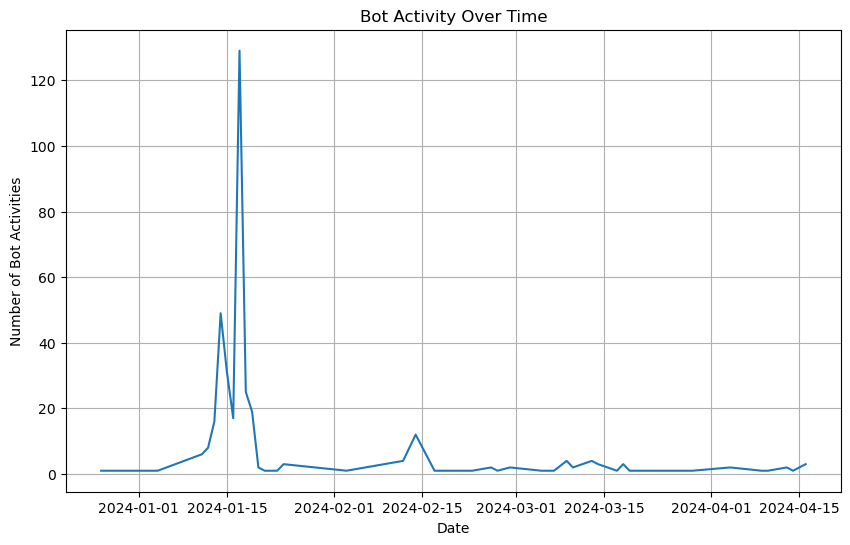

In [20]:
df_bots = df_users[df_users['isBot'] == 1]

bot_activity_over_time = df_bots.groupby(df_bots['created_at'].dt.date).size()

# Plot the results using a line graph
plt.figure(figsize=(10, 6))
bot_activity_over_time.plot(kind='line')
plt.title('Bot Activity Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Bot Activities')
plt.grid(True)
plt.show()

Bot Activity Over Time
- The graph shows a sharp peak in bot activity around mid-January 2024, with the highest count exceeding 120 activities on a single day.
- Prior to mid-January, the bot activity gradually increases, reaching around 40 activities.
- Following the peak in mid-January, the bot activity rapidly decreases showing minor fluctuations with some smaller peaks in early February and late February,reaching around 20 counts.

In [21]:
# Ensure the index is in datetime format
bot_activity_over_time.index = pd.to_datetime(bot_activity_over_time.index)

filtered_bot_activity = bot_activity_over_time.loc['2024-01-13':'2024-01-19']
filtered_bot_activity

created_at
2024-01-13     16
2024-01-14     49
2024-01-15     31
2024-01-16     17
2024-01-17    129
2024-01-18     25
2024-01-19     19
dtype: int64

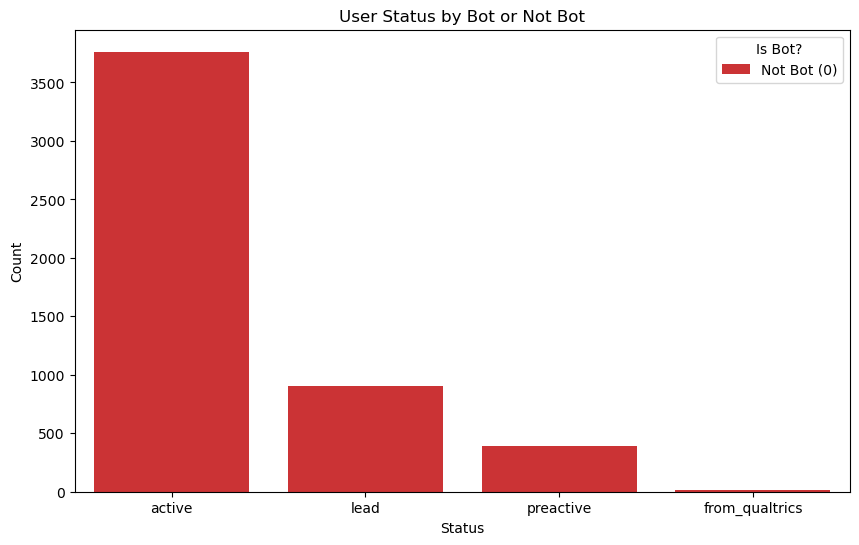

In [22]:
df_users['isBot'] = df_users['isBot'].map({'t': 1}).fillna(0)

# Plotting
plt.figure(figsize=(10, 6))
ax = sns.countplot(x='status', hue='isBot', data=df_users, palette='Set1')
plt.title('User Status by Bot or Not Bot')
plt.xlabel('Status')
plt.ylabel('Count')

handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, ['Not Bot (0)', 'Is Bot (1)'], title='Is Bot?')

plt.show()


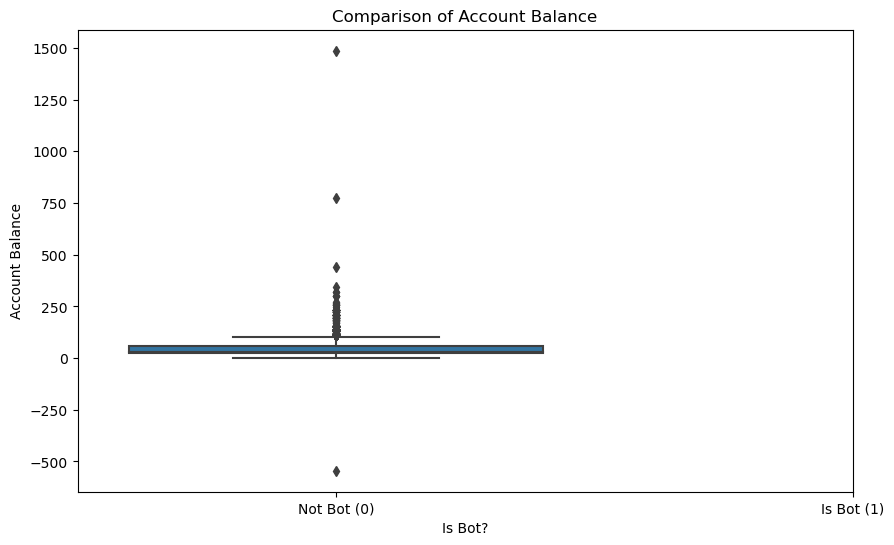

In [23]:
# plot for balances
plt.figure(figsize=(10, 6))
sns.boxplot(x='isBot', y='balance', data=df_users)
plt.title('Comparison of Account Balance')
plt.xlabel('Is Bot?')
plt.ylabel('Account Balance')
plt.xticks([0, 1], ['Not Bot (0)', 'Is Bot (1)'])
plt.show()


The box plot indicates that non-bot accounts tend to have more variability in their account balances, with higher and lower extremes compared to bot accounts. Bot accounts, on the other hand, show more consistent account balances, with less variability and fewer extreme values.

- The y-axis is labeled "Account Balance", with the range approximately from -500 to 1500.
- Both groups have a significant number of outliers, but the outliers for "Not Bot (0)" extend much higher (up to approximately 1500) than those for "Is Bot (1)".
- There is also a notable outlier below -500 for the "Is Bot (1)" group. Later it was confirmed this was a bot.

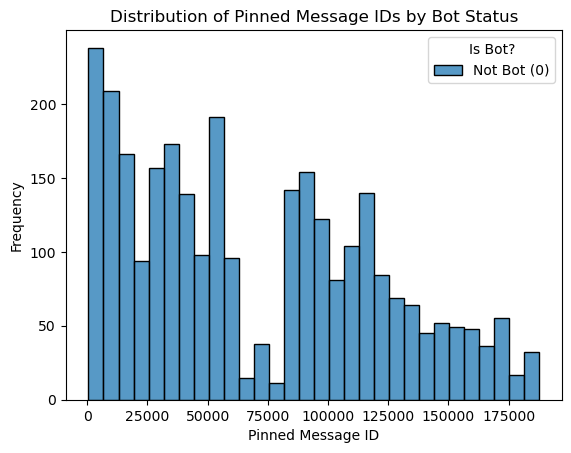

In [24]:
#plot for pinned message ids
sns.histplot(data=df_users, x='pined_msg_id', hue='isBot', multiple='stack', bins=30)
plt.title('Distribution of Pinned Message IDs by Bot Status')
plt.xlabel('Pinned Message ID')
plt.ylabel('Frequency')
plt.legend(title='Is Bot?', labels=['Not Bot (0)', 'Is Bot (1)'])
plt.show()


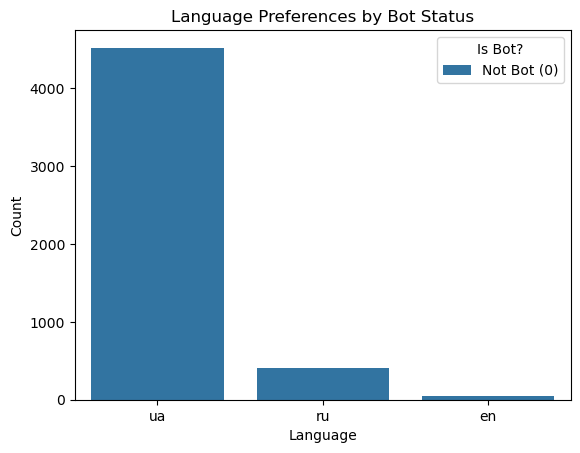

In [25]:
# Plot for languange preferences
sns.countplot(x='lang', hue='isBot', data=df_users)
plt.title('Language Preferences by Bot Status')
plt.xlabel('Language')
plt.ylabel('Count')
plt.legend(title='Is Bot?', labels=['Not Bot (0)', 'Is Bot (1)'])
plt.show()


A significant majority of non-bot users prefer the 'ua' Ukranian language, with over 4000 users, and the most Bots.

A smaller number of non-bot users prefer 'ru', and even fewer prefer 'en'. Bots are present in smaller numbers for 'ua' and 'ru' languages, with 'ua' still being the more preferred language among bots.

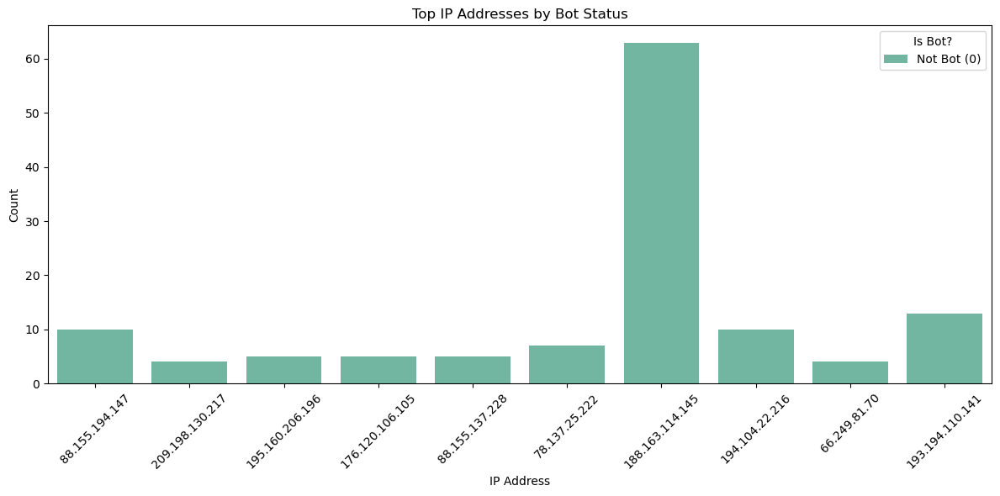

In [26]:
top_ips = df_users['ip'].value_counts().nlargest(10).index
filtered_data = df_users[df_users['ip'].isin(top_ips)]

# plot for IP addresses
plt.figure(figsize=(12, 6)) 
ax = sns.countplot(x='ip', hue='isBot', data=filtered_data, palette='Set2')
plt.title('Top IP Addresses by Bot Status')
plt.xlabel('IP Address')
plt.ylabel('Count')
plt.xticks(rotation=45)  
plt.legend(title='Is Bot?', labels=['Not Bot (0)', 'Is Bot (1)'])

plt.tight_layout() 
plt.show()

Top IP Addresses by Bot Status

The x-axis lists specific IP addresses, while the y-axis shows the count of occurrences for each IP address.

- The IP address 188.163.114.145 is predominantly associated with bots, with a count of around 60.
- Other IP addresses such as 209.198.130.217 and 176.120.106.105 show a mix of both bot and non-bot users.
- Some IP addresses like 88.155.134.147 and 194.104.22.216 have more non-bot users than bots.

Overall, specific IP addresses are heavily indicative of bot activity, especially the most frequent ones.

count    3730.000000
mean        1.084450
std         1.099794
min         1.000000
25%         1.000000
50%         1.000000
75%         1.000000
max        63.000000
Name: count, dtype: float64


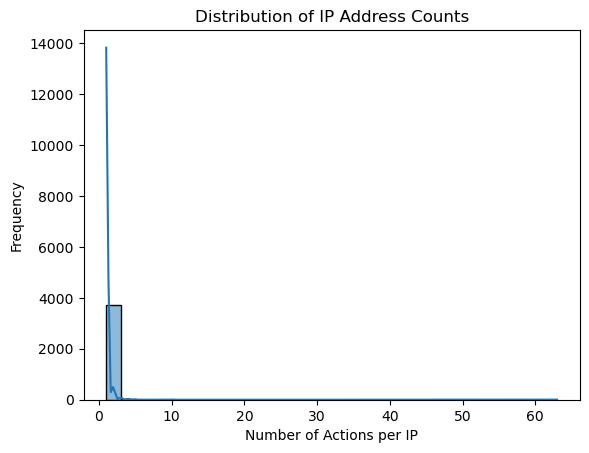

Threshold for suspicious IP count: 1.0


In [27]:
ip_counts = df_users['ip'].value_counts()

print(ip_counts.describe())

sns.histplot(ip_counts, bins=30, kde=True)
plt.title('Distribution of IP Address Counts')
plt.xlabel('Number of Actions per IP')
plt.ylabel('Frequency')

plt.show()

high_threshold = ip_counts.quantile(0.95) 
print("Threshold for suspicious IP count:", high_threshold)

Most accounts have 1 IP count, looking for accounts with 3 or above could be suspicious, 3 to account for mobile and laptop/computer.


In [28]:
df_users['data_fraud_referral_ancestor'].value_counts()

data_fraud_referral_ancestor
815c3170-3cf1-407f-b9f6-bdc1083b5b2b    100
0b9f3807-64e0-4d25-bead-5b318b7e73d0     99
6c2511d2-43d0-4b05-8ce3-d40a66537a10     67
5611c613-07cf-4489-8a91-3dedbb1f9ccd     38
be3b3656-5ba2-4720-9617-c725505e7690     22
                                       ... 
c2597bfe-98ac-4394-a6f0-c7b9b4e3a227      1
97e70f80-c7cc-4c43-b69e-52a329cab7ba      1
099f7832-af51-4ca8-8f7c-236d46cfbfdd      1
c8ec4c23-4f30-4ef2-a458-7f817302f2aa      1
e287453c-7e91-4842-8e19-c2599230d8f5      1
Name: count, Length: 73, dtype: int64

In [29]:
df_users['data_fraud_referral_ancestor'] = df_users['data_fraud_referral_ancestor'].fillna('Unknown')
df_users['data_fraud_referral_ancestor'].value_counts()

data_fraud_referral_ancestor
Unknown                                 4580
815c3170-3cf1-407f-b9f6-bdc1083b5b2b     100
0b9f3807-64e0-4d25-bead-5b318b7e73d0      99
6c2511d2-43d0-4b05-8ce3-d40a66537a10      67
5611c613-07cf-4489-8a91-3dedbb1f9ccd      38
                                        ... 
c2597bfe-98ac-4394-a6f0-c7b9b4e3a227       1
97e70f80-c7cc-4c43-b69e-52a329cab7ba       1
099f7832-af51-4ca8-8f7c-236d46cfbfdd       1
c8ec4c23-4f30-4ef2-a458-7f817302f2aa       1
e287453c-7e91-4842-8e19-c2599230d8f5       1
Name: count, Length: 74, dtype: int64

In [30]:
campaign_counts = df_users.groupby(['user_id', 'campaign']).size().reset_index(name='counts')

Top users by campaign counts:
         user_id        campaign  counts
0        5856661   ad_fb_kolbasa       1
2139  1355200425  ad_fb_produkti       1
2129  1346422121     ad_tg_palia       1
2130  1346424165  ad_tgjobskyiv5       1
2131  1346518867    ad_fb_pizza1       1
2132  1347398301    ad_fb_pizza2       1
2133  1348346917      ad_fb_smet       1
2134  1350400951      ad_fb_smet       1
2135  1351718930     ad_fb_milk2       1
2136  1353639946      ad_fb_smet       1


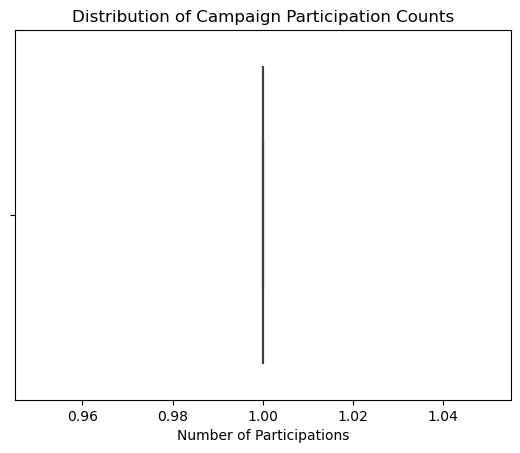

In [31]:
campaign_counts = df_users.groupby(['user_id', 'campaign']).size().reset_index(name='counts')

top_campaign_users = campaign_counts.sort_values(by='counts', ascending=False).head(10)
print("Top users by campaign counts:")
print(top_campaign_users)

sns.boxplot(x=campaign_counts['counts'])
plt.title('Distribution of Campaign Participation Counts')
plt.xlabel('Number of Participations')
plt.show()


Users only come from 1 campaign.

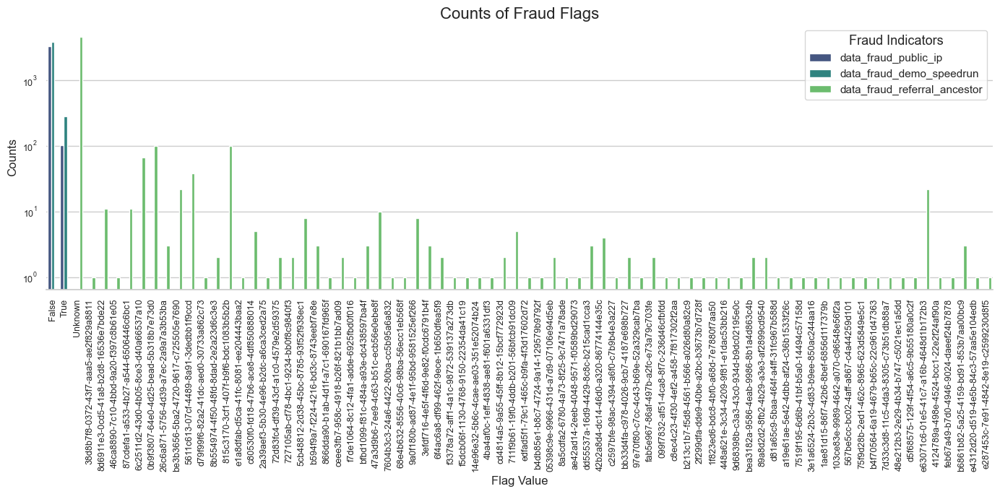

In [32]:
fraud_flags = df_users[['data_fraud_public_ip', 'data_fraud_demo_speedrun', 'data_fraud_referral_ancestor']].melt()


sns.set(style="whitegrid")  

plt.figure(figsize=(14, 7))  

ax = sns.countplot(x='value', hue='variable', data=fraud_flags, palette='viridis')
plt.title('Counts of Fraud Flags', fontsize=16)
plt.xlabel('Flag Value', fontsize=12)
plt.ylabel('Counts', fontsize=12)

ax.set_yscale('log') 

plt.legend(title='Fraud Indicators', title_fontsize='13', fontsize='11')  
plt.xticks(rotation=90, fontsize=9) 
plt.yticks(fontsize=9)

sns.despine(left=True) 

plt.tight_layout() 
plt.show() 

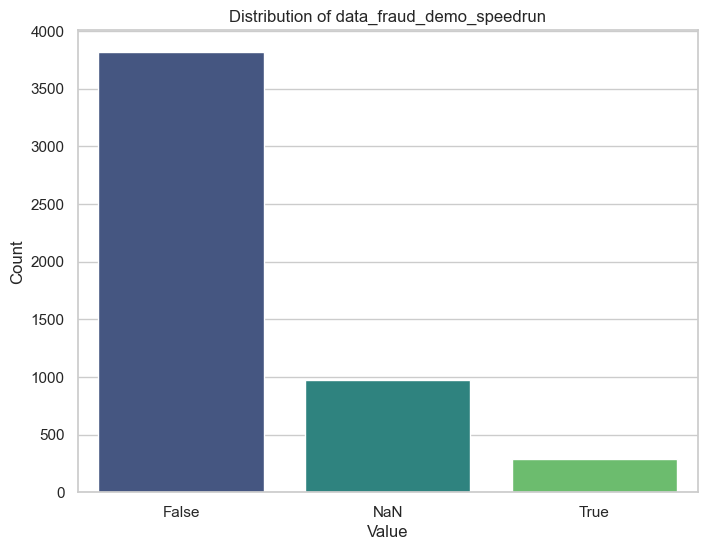

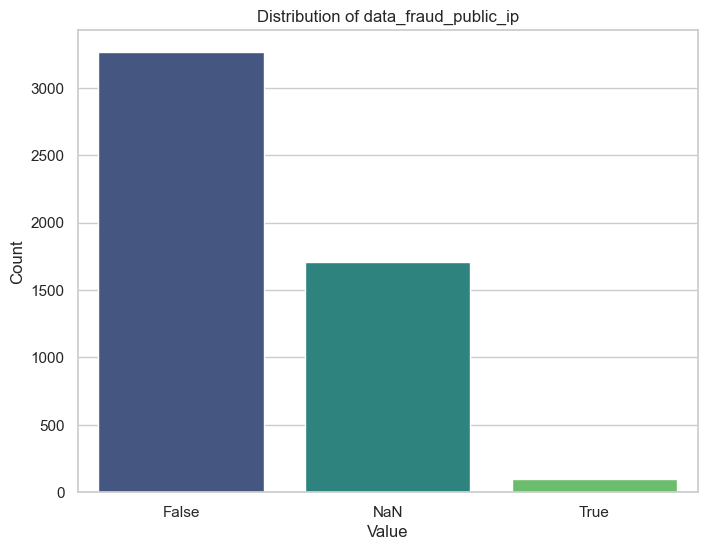

In [33]:
value_counts_speedrun = df_users['data_fraud_demo_speedrun'].fillna('NaN').value_counts()
value_counts_ip = df_users['data_fraud_public_ip'].fillna('NaN').value_counts()

palette = 'viridis' 

# Plot data_fraud_demo_speedrun
plt.figure(figsize=(8, 6))
sns.barplot(x=value_counts_speedrun.index, y=value_counts_speedrun, palette=palette)
plt.title('Distribution of data_fraud_demo_speedrun')
plt.xlabel('Value')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()

# Plot data_fraud_public_ip
plt.figure(figsize=(8, 6))
sns.barplot(x=value_counts_ip.index, y=value_counts_ip, palette=palette)
plt.title('Distribution of data_fraud_public_ip')
plt.xlabel('Value')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()


Flag Value meaning:
 
data_fraud_demo_speedrun: A boolean feature that is based on the duration of the survey. Answering the questions takes time. If the respondents answered too fast probably they are not human, and are assigned a 'True' value.

data_fraud_public_ip: fraud suspected from ip, marked as 'True'


Graphs

Distribution of data_fraud_public_ip

- The majority of the data points fall under the "False" category, with over 3000 occurrences.
- A significant number of data points are "NaN" (missing values), with around 1500 occurrences.
- The "True" category has the fewest occurrences, with less than 100, but these indicate that the ip is suspected fraud

Distribution of data_fraud_demo_speedrun

- Most of the data points are in the "False" category, with nearly 4000 occurrences.
- There are about 1000 data points with "NaN" (missing values).
- The "True" category has less than 500 occurrences, but indicates a users went through the survey too fast.

Many NanN values are present due to users not yet taking certain surveys.


## Users Feature Engineering <a id=3></a>

In [34]:
#Data Fraud 
fraud_filtered_df = df_users[(df_users['data_fraud_demo_speedrun'] == True) & (df_users['data_fraud_public_ip'] == True)]

print(fraud_filtered_df)

         id     user_id     status                 created_at  balance  \
266    2980  1406563246     active 2024-03-13 21:43:46.324102       27   
358    2394  1457518234     active 2024-03-07 15:18:47.331365       27   
1115   1695  1817861816     active 2024-02-29 16:59:45.541908        6   
1281   2930  2015677597     active 2024-03-13 16:03:32.953610       32   
1332    883  5236333770     active 2024-01-19 15:11:40.932019       10   
1955   2965  5307554906     active 2024-03-13 19:52:23.653745       32   
2040  10460   358225008     active 2024-04-06 16:58:23.624745      110   
2609   3059   770941112     active 2024-03-14 17:24:54.233968       27   
3139    984   801351815     active 2024-02-12 15:05:15.884577       32   
3668   1379  5951076092     active 2024-02-26 16:59:50.919509       32   
3702    985  6213883060     active 2024-02-12 15:19:18.404532       32   
3734   2003  6452784832     active 2024-03-05 21:13:56.750895       32   
3768  10439  6651678977     active 202

In [35]:
columns_to_encode = ['data_fraud_public_ip', 'data_fraud_demo_speedrun', 'data_fraud_referral_ancestor']

# Function to one-hot encode a single column 
def one_hot_encode_column(df, column):
    encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
    encoded_features = encoder.fit_transform(df[[column]])
    encoded_df = pd.DataFrame(encoded_features, columns=encoder.get_feature_names_out([column]))
    return encoded_df

# One-hot encode each column separately
for column in columns_to_encode:
    encoded_df = one_hot_encode_column(df_users, column)
    df_users = pd.concat([df_users, encoded_df], axis=1)

df_users


,id,user_id,status,created_at,balance,uuid,pined_msg_id,came_from,lang,jira_task,...,data_fraud_referral_ancestor_e1a8dfab-d5ca-41fc-8081-ee204443baa2,data_fraud_referral_ancestor_e287453c-7e91-4842-8e19-c2599230d8f5,data_fraud_referral_ancestor_e4312d20-d519-4e5b-84c3-57aa5e104edb,data_fraud_referral_ancestor_e63071c6-01e5-41c7-a16b-4648d1b172b3,data_fraud_referral_ancestor_edfad5f1-79c1-465c-b9fa-4f3d17602d72,data_fraud_referral_ancestor_f3378a72-aff1-4a1c-9872-539137a273db,data_fraud_referral_ancestor_f5dcb06f-1130-4768-9150-22354da41c19,data_fraud_referral_ancestor_f7de1064-8c12-4fa1-adde-6925fbd0f016,data_fraud_referral_ancestor_fab5e967-86af-497b-a2fc-e73a79c703fe,data_fraud_referral_ancestor_feb67a49-b7d0-4946-9024-daeef24b7878
0,11230,639539048,active,2024-04-16 07:47:42.064104,27,4a50c590-374e-4e91-87f5-11ccfc47ce55,174848.0,NaN,ua,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,3349,612174706,active,2024-03-18 07:15:10.928451,110,ebffd100-2e64-43a6-abe9-acf0cfe3f42d,96604.0,NaN,ua,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,10085,616454733,active,2024-04-01 16:17:05.530395,136,1dd2adbd-9848-4bcd-91d5-4a4638608857,NaN,NaN,ua,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,10805,833975449,active,2024-04-11 09:35:54.153091,110,1ef2bc6b-cc33-4512-8cb6-11d5915853fe,NaN,NaN,ua,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,3355,251643453,active,2024-03-18 08:03:52.302407,110,55c7a1b8-39c5-4094-a770-7a3b2bd67307,96701.0,NaN,ua,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5067,10446,7089447758,active,2024-04-06 13:34:31.063807,110,c2a57f10-8813-4c11-ab5f-296dd7922603,NaN,NaN,ru,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5068,2998,7092164253,active,2024-03-14 07:34:12.485543,0,56af592b-3354-4001-a86e-efe8ae434296,88272.0,NaN,ua,TBC-202,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5069,3311,7096422139,active,2024-03-17 16:27:23.159667,58,f60f59b8-5511-4437-b3bd-ca3d059bb38f,NaN,NaN,ua,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5070,9973,7100774719,active,2024-03-30 18:54:03.553307,32,479499b6-f353-4002-bc1a-26d8816c8e98,126608.0,NaN,en,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [36]:
# Repeated ip
df_users['repeated_ip'] = df_users['data_fraud_public_ip'].duplicated(keep=False)

# Repeated referral ancestor
df_users = df_users[df_users['data_fraud_referral_ancestor'] != 'Unknown']
referral_counts = df_users['data_fraud_referral_ancestor'].value_counts()

# Calculate IQR for the counts
Q1 = referral_counts.quantile(0.25)
Q3 = referral_counts.quantile(0.75)
IQR = Q3 - Q1

# Determine the upper bound for outliers
upper_bound = Q3 + 1.5 * IQR

# Create a column to flag high referral ancestors
df_users['high_referral_ancestor'] = df_users['data_fraud_referral_ancestor'].apply(lambda x: referral_counts[x] > upper_bound)

#Campaign is ad
df_users['campaign_is_ad'] = df_users['campaign'].str.lower().str.contains('ad')

print(df_users.head())

        id     user_id  status                 created_at  balance  \
13   10976   388337942  active 2024-04-12 20:13:31.609956       27   
25    1200   619213102  active 2024-02-20 17:52:26.288647       32   
55   10807   374728311  active 2024-04-11 10:16:04.775589      110   
69    9218   622155379    lead 2024-03-20 15:18:03.346954       10   
107   9654  1043790324  active 2024-03-26 21:39:55.914594       59   

                                     uuid  pined_msg_id  \
13   dcb076ce-548d-4e7a-b6c9-e0aed5b08fbf      164292.0   
25   283ce3fe-7d9a-49e1-866a-f61782103f73       31278.0   
55   7dabcaad-94b0-4ba9-a316-672de5873117      154304.0   
69   b46dd2f1-d6ac-49bd-8837-23bdf4035acf      104035.0   
107  849abf30-42f5-420f-b56f-b0d7e3f4b9a9      118364.0   

                                came_from lang jira_task  ...  \
13   38d8b7f8-0372-43f7-aaa5-ae2f829a8811   ua       NaN  ...   
25   8d6911e3-0cd5-41a8-b2d8-16536e7bde22   ru       NaN  ...   
55   46ca8890-7c10-4bbd-9a20-

In [37]:
df_users = df_users[df_users['data_fraud_referral_ancestor'] != 'Unknown']

# Compute value counts
value_counts = df_users['data_fraud_referral_ancestor'].value_counts()

filtered_value_counts = value_counts[(value_counts > 20) & (value_counts < 4000)]
df_users['high_referral_ancestor_encoded'] = df_users['data_fraud_referral_ancestor'].apply(
    lambda x: 1 if x in filtered_value_counts.index else 0
)

In [38]:
df_users['high_referral_ancestor_encoded']

13      0
25      0
55      0
69      0
107     1
       ..
5041    1
5044    1
5046    1
5049    1
5062    0
Name: high_referral_ancestor_encoded, Length: 492, dtype: int64

In [39]:
filtered_value_counts

data_fraud_referral_ancestor
815c3170-3cf1-407f-b9f6-bdc1083b5b2b    100
0b9f3807-64e0-4d25-bead-5b318b7e73d0     99
6c2511d2-43d0-4b05-8ce3-d40a66537a10     67
5611c613-07cf-4489-8a91-3dedbb1f9ccd     38
be3b3656-5ba2-4720-9617-c725505e7690     22
e63071c6-01e5-41c7-a16b-4648d1b172b3     22
Name: count, dtype: int64

In [40]:
df_users['high_referral_ancestor']

13      False
25       True
55      False
69       True
107      True
        ...  
5041     True
5044     True
5046     True
5049     True
5062    False
Name: high_referral_ancestor, Length: 492, dtype: bool

## Users Event Log Dataset <a id=4></a>

In [43]:
df_users_event_log= pd.read_csv('users_event_log.csv')
df_users_event_log.head()

,id,event,ip,agent,created_at,extra_data,user_id,recaptcha_score,comment,proxy_used
0,7,presurvey,2a00:a041:33dd:f800:6c2d:b6fb:faed:2546,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-02 00:00:00,"{""cookie"": ""rl_page_init_referrer=RudderEncryp...",139158113,0.9,NaN,t
1,8,presurvey,2a00:a041:33dd:f800:6c2d:b6fb:faed:2546,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-02 00:00:00,"{""cookie"": ""rl_page_init_referrer=RudderEncryp...",139158113,NaN,timeout-or-duplicate,t
2,9,presurvey,2a00:a041:33dd:f800:fd76:ad0b:4a9e:9a01,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-03 00:00:00,"{""cookie"": ""rl_page_init_referrer=RudderEncryp...",139158113,NaN,timeout-or-duplicate,t
3,10,presurvey,2a00:a041:33dd:f800:fd76:ad0b:4a9e:9a01,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-03 00:00:00,"{""cookie"": ""rl_page_init_referrer=RudderEncryp...",139158113,NaN,timeout-or-duplicate,t
4,12,presurvey,2a00:a041:33dd:f800:fd76:ad0b:4a9e:9a01,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-03 00:00:00,"{""cookie"": ""rl_page_init_referrer=RudderEncryp...",139158113,NaN,timeout-or-duplicate,t


### Users Event Log Feature Engineering

In [44]:
# Relevant columns
user_event_log_columns = ['user_id', 'event', 'recaptcha_score', 'proxy_used']

# New df with only the relevant columns
users_event_log_df = df_users_event_log[user_event_log_columns]

print(users_event_log_df)

         user_id      event  recaptcha_score proxy_used
0      139158113  presurvey              0.9          t
1      139158113  presurvey              NaN          t
2      139158113  presurvey              NaN          t
3      139158113  presurvey              NaN          t
4      139158113  presurvey              NaN          t
...          ...        ...              ...        ...
9276   837476313       shop              0.9        NaN
9277  1258390478  presurvey              0.9          t
9278   484166157  presurvey              0.9          t
9279   285899480       shop              0.9        NaN
9280  5775643998       shop              0.9        NaN

[9281 rows x 4 columns]


In [46]:
# Define parse and load json
def parse_json(json_str):
    try:
        return json.loads(json_str)

    except (json.JSONDecodeError, TypeError):
        return None

def load_data(data_file_url, json_column_names):
    df = pd.read_csv(data_file_url, sep=",", converters={column: parse_json for column in json_column_names})

    for column in json_column_names:
        column_as_df = pd.json_normalize(df[column])
        column_as_df.columns = [f"{column}_{subcolumn}" for subcolumn in column_as_df.columns]
        df = df.drop(column, axis=1).merge(column_as_df, right_index=True, left_index=True)
        
    return df

JSON_COLUMNS = ['extra_data']

df_users_event_log = load_data('users_event_log.csv', JSON_COLUMNS )

In [47]:
df_users_event_log.head()

,id,event,ip,agent,created_at,user_id,recaptcha_score,comment,proxy_used,extra_data_cookie,...,extra_data_sec-ch-ua-full-version-list,extra_data_sec-fetch-user,extra_data_dnt,extra_data_save-data,extra_data_sec-gpc,extra_data_x-requested-with,extra_data_x-enrichmentstatus,extra_data_via,extra_data_x-imforwards,extra_data_cache-control
0,7,presurvey,2a00:a041:33dd:f800:6c2d:b6fb:faed:2546,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-02 00:00:00,139158113,0.9,NaN,t,rl_page_init_referrer=RudderEncrypt%3AU2FsdGVk...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,8,presurvey,2a00:a041:33dd:f800:6c2d:b6fb:faed:2546,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-02 00:00:00,139158113,NaN,timeout-or-duplicate,t,rl_page_init_referrer=RudderEncrypt%3AU2FsdGVk...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,9,presurvey,2a00:a041:33dd:f800:fd76:ad0b:4a9e:9a01,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-03 00:00:00,139158113,NaN,timeout-or-duplicate,t,rl_page_init_referrer=RudderEncrypt%3AU2FsdGVk...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,10,presurvey,2a00:a041:33dd:f800:fd76:ad0b:4a9e:9a01,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-03 00:00:00,139158113,NaN,timeout-or-duplicate,t,rl_page_init_referrer=RudderEncrypt%3AU2FsdGVk...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,12,presurvey,2a00:a041:33dd:f800:fd76:ad0b:4a9e:9a01,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7...,2024-02-03 00:00:00,139158113,NaN,timeout-or-duplicate,t,rl_page_init_referrer=RudderEncrypt%3AU2FsdGVk...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [48]:
users_event_log_profile = ProfileReport(df_users_event_log, title="Users Event Log Profiling Report")
users_event_log_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [50]:
df_referrals= pd.read_csv('referrals.csv')

In [51]:
df_referrals.head()

,id,uuid,pushed,created_at,error
0,4,2bd06c9b-20b9-49d1-8527-5fd2ee0b723b,t,2023-12-13 00:33:11.588141,NaN
1,5,1fb2f937-5cb6-45e6-876c-136a4dd23db9,t,2023-12-13 08:36:16.042615,NaN
2,7,ce3a5735-7678-4044-bb43-2275f12a740c,t,2023-12-13 08:37:21.522121,NaN
3,8,2b844b41-2e10-4487-b380-d4e6ed4d3d2b,t,2023-12-13 08:37:21.522121,NaN
4,9,cb1c454c-41bf-438e-80b9-2d4ab6d48312,t,2023-12-13 08:37:21.522121,NaN


In [52]:
df_referrals.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 498 entries, 0 to 497
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   id          498 non-null    int64 
 1   uuid        498 non-null    object
 2   pushed      461 non-null    object
 3   created_at  498 non-null    object
 4   error       37 non-null     object
dtypes: int64(1), object(4)
memory usage: 19.6+ KB


## Profile Dataset <a id=6></a>

In [53]:
df_profile= pd.read_csv('profile.csv')
df_profile.columns

Index(['id', 'user_id', 'demography_body', 'age_min', 'age_max', 'gender',
       'created_at', 'age', 'country', 'eyal_answers', 'silvana_answers'],
      dtype='object')

In [54]:
print(df_profile['demography_body'])

0       {"labels": {"QID2": "Male", "QID3": "Married",...
1       {"labels": {"QID2": "Male", "QID3": "Complicat...
2       {"labels": {"QID1": "FB", "QID2": "Female", "Q...
3       {"labels": {"QID1": "Friend", "QID2": "Male", ...
4       {"labels": {"QID1": "Click to write Choice 6",...
                              ...                        
4225    {"labels": {"QID1": "Community", "QID2": "Fema...
4226    {"labels": {"QID2": "Female", "QID3": "Married...
4227    {"labels": {"QID1": "Friend", "QID2": "Female"...
4228    {"labels": {"QID1": "Community", "QID2": "Fema...
4229    {"labels": {"QID1": "Click to write Choice 6",...
Name: demography_body, Length: 4230, dtype: object


### Profile Feature Engineering

In [55]:
# Convert age range to average
df_profile['age'] = (df_profile['age_min'] + df_profile['age_max']) / 2

# Extract Duration
df_profile['duration'] = df_profile['demography_body'].apply(lambda x: pd.json_normalize(eval(x))['values.duration'])

# Encode Gender
gender_encoder = LabelEncoder()
df_profile['gender_encoded'] = gender_encoder.fit_transform(df_profile['gender'])

# Create Binary col for 'from_ukraine' 1 from, 0 not
df_profile['from_ukraine'] = (df_profile['country'] == 'Ukraine').astype(int)

profile_columns = ['id', 'user_id', 'gender_encoded', 'age', 'duration', 'from_ukraine']

profile_columns = df_profile[profile_columns]

print(profile_columns)


        id     user_id  gender_encoded   age  duration  from_ukraine
0     1268   544860584               1  49.5       611             0
1      960  1047000229               1  29.5       596             0
2      908   865654491               0  29.5       477             0
3     1278   635305682               1  39.5       513             0
4     1162  5680929352               0  39.5      1349             0
...    ...         ...             ...   ...       ...           ...
4225  4446  1068695905               0  21.0       939             0
4226  4447   378497155               0  29.5       553             0
4227  4448   697051190               0  21.0       364             0
4228  4449   484166157               0  29.5       416             0
4229  4450  1258390478               0  21.0       561             0

[4230 rows x 6 columns]


In [56]:
print(df_profile['demography_body'].to_string(index=False))

{"labels": {"QID2": "Male", "QID3": "Married", ...
{"labels": {"QID2": "Male", "QID3": "Complicate...
{"labels": {"QID1": "FB", "QID2": "Female", "QI...
{"labels": {"QID1": "Friend", "QID2": "Male", "...
{"labels": {"QID1": "Click to write Choice 6", ...
{"labels": {"QID1": "35-44", "QID2": "Female", ...
{"labels": {"QID1": "Click to write Choice 6", ...
{"labels": {"QID1": "18-24", "QID2": "Female", ...
{"labels": {"QID1": "Click to write Choice 6", ...
{"labels": {"QID1": "Google", "QID2": "Female",...
{"labels": {"QID1": "Friend", "QID2": "Male", "...
{"labels": {"QID2": "Female", "QID3": "Relation...
{"labels": {"QID2": "Male", "QID3": "Single", "...
{"labels": {"QID2": "Female", "QID3": "Married"...
{"labels": {"QID2": "Female", "QID3": "Married"...
{"labels": {"QID1": "Click to write Choice 5", ...
{"labels": {"QID2": "Female", "QID3": "Single",...
{"labels": {"QID1": "Click to write Choice 5", ...
{"labels": {"QID2": "Male", "QID3": "Married", ...
{"labels": {"QID1": "18-24", "Q

In [57]:
def parse_json(json_str):
    try:
        return json.loads(json_str)
    except (json.JSONDecodeError, TypeError):
        return None

def load_data(data_file_url, json_column_names):
    df = pd.read_csv(data_file_url, sep=",", converters={column: parse_json for column in json_column_names})
    for column in json_column_names:
        column_as_df = pd.json_normalize(df[column].apply(lambda x: x if x is not None else {}))
        column_as_df.columns = [f"{column}_{subcolumn}" for subcolumn in column_as_df.columns]
        df = df.drop(column, axis=1).join(column_as_df, how='left')
    return df

JSON_COLUMNS = ['eyal_answers', 'demography_body']  
data_file_url = 'profile.csv'  

df_profile = load_data(data_file_url, JSON_COLUMNS)
print(df_profile.columns)

Index(['id', 'user_id', 'age_min', 'age_max', 'gender', 'created_at', 'age',
       'country', 'silvana_answers', 'eyal_answers_responseId',
       ...
       'demography_body_labels.QID58', 'demography_body_values.QID58',
       'demography_body_values.Q_RelevantIDDuplicate',
       'demography_body_values.Q_RelevantIDLastStartDate',
       'demography_body_values.QID60_TEXT', 'demography_body_labels.QID59',
       'demography_body_labels.QID59_DO', 'demography_body_values.QID59',
       'demography_body_values.QID59_DO',
       'demography_body_displayedValues.QID59'],
      dtype='object', length=449)


In [58]:
df_profile.head()

,id,user_id,age_min,age_max,gender,created_at,age,country,silvana_answers,eyal_answers_responseId,...,demography_body_labels.QID58,demography_body_values.QID58,demography_body_values.Q_RelevantIDDuplicate,demography_body_values.Q_RelevantIDLastStartDate,demography_body_values.QID60_TEXT,demography_body_labels.QID59,demography_body_labels.QID59_DO,demography_body_values.QID59,demography_body_values.QID59_DO,demography_body_displayedValues.QID59
0,1268,544860584,45,54,male,2024-03-05 09:50:38.316897,45-54,ukraine,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,960,1047000229,25,34,male,2024-02-28 09:31:13.869523,25-34,ukraine,NaN,R_6rs5q0myICEXkSR,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,908,865654491,25,34,female,2024-02-27 12:03:40.726419,25-34,ukraine,NaN,R_4PdFKKPOPX5fN3H,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1278,635305682,35,44,male,2024-03-05 15:02:30.32342,35-44,ukraine,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1162,5680929352,35,44,female,2024-03-03 16:01:59.324326,35-44,ukraine,NaN,R_7XbVwQnL7nWR2jN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [59]:
columns_to_profile = ['id', 'user_id', 'age_min', 'age_max', 'gender', 'created_at', 
                      'country', 'age', 'silvana_answers', 'eyal_answers_responseId']

# profile report for selected columns
profile = ProfileReport(df_profile[columns_to_profile], title="Profile Report for Selected Columns")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [60]:
df_profile['fraud_score']= df_profile['eyal_answers_values.Q_RelevantIDFraudScore']
df_profile['fraud_score']

0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
        ..
4225   NaN
4226   NaN
4227   NaN
4228   NaN
4229   NaN
Name: fraud_score, Length: 4230, dtype: float64

In [61]:
print(df_profile['demography_body_values.duration'])

0        611
1        596
2        477
3        513
4       1349
        ... 
4225     939
4226     553
4227     364
4228     416
4229     561
Name: demography_body_values.duration, Length: 4230, dtype: int64


In [62]:
df_profile['demography_body_values.duration'].describe()


count      4230.000000
mean       1834.345863
std       18841.477472
min          33.000000
25%         355.000000
50%         479.000000
75%         676.000000
max      601186.000000
Name: demography_body_values.duration, dtype: float64

**demography_body_values.duration** and **eyal_answers_values.duration** are columns for how much time a user took to complete the demography survey, and eyal_anwers survey.

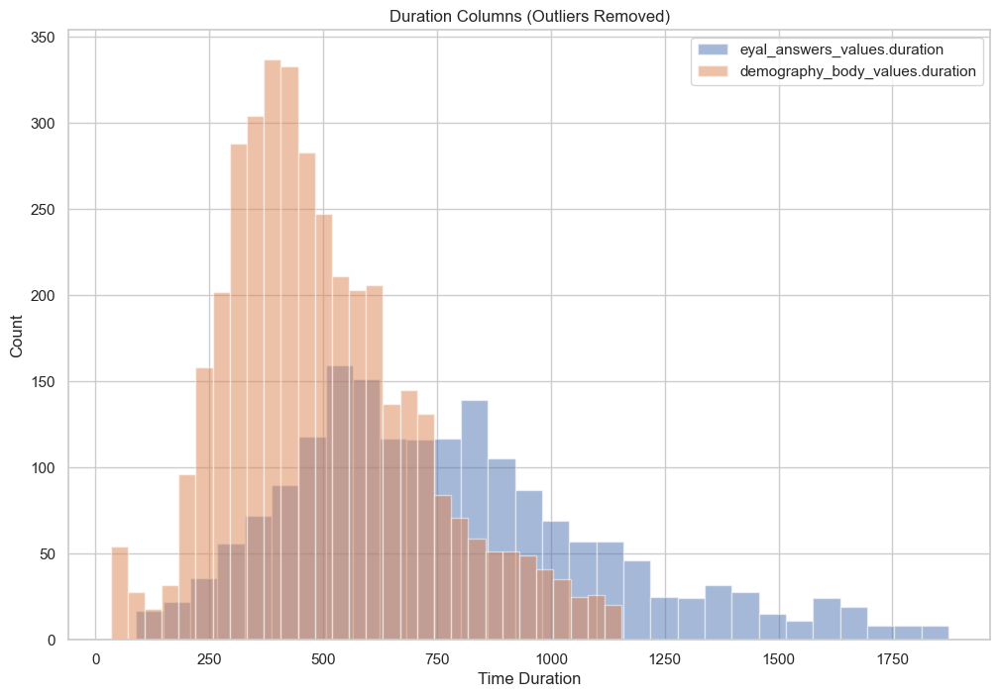

In [63]:
duration_columns = [col for col in df_profile.columns if 'duration' in col]

# Function to remove outliers
def remove_outliers(data, threshold=1.5):
    Q1 = data.quantile(0.25)
    Q3 = data.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - threshold * IQR
    upper_bound = Q3 + threshold * IQR
    return data[(data >= lower_bound) & (data <= upper_bound)]

# Plotting histograms for each duration column with outlier removal
plt.figure(figsize=(12, 8))

for col in duration_columns:
    if pd.api.types.is_numeric_dtype(df_profile[col]):
        cleaned_data = remove_outliers(df_profile[col].dropna())
        plt.hist(cleaned_data, bins=30, alpha=0.5, label=col)

plt.xlabel('Time Duration')
plt.ylabel('Count')
plt.title('Duration Columns (Outliers Removed)')
plt.legend()
plt.show()


In [64]:
duration_columns = [col for col in df_profile.columns if 'duration' in col]

# Create dictionary
outliers = {}

# Identify and remove outliers
for col in duration_columns:
    Q1 = df_profile[col].quantile(0.25)
    Q3 = df_profile[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Find outliers
    col_outliers = df_profile[(df_profile[col] < lower_bound) | (df_profile[col] > upper_bound)][col]
    outliers[col] = col_outliers
    
    # Remove outliers from the original dataframe
    df_profile = df_profile[~df_profile.index.isin(col_outliers.index)]

for col, col_outliers in outliers.items():
    print(f"Outliers in {col}:")
    print(col_outliers)
    print()


Outliers in eyal_answers_values.duration:
32       2254.0
63       3968.0
68       2136.0
147      3904.0
208      2117.0
         ...   
3838     3441.0
3882    31807.0
3897     2295.0
3908     6958.0
4078    15544.0
Name: eyal_answers_values.duration, Length: 181, dtype: float64

Outliers in demography_body_values.duration:
4        1349
14       1453
36      73119
37       8445
38       1467
        ...  
4118    92505
4160     1415
4189     2999
4209     2262
4220     1163
Name: demography_body_values.duration, Length: 276, dtype: int64



In [65]:
#QIDS to look into:
q10_sample = df_profile.filter(like='QID10').head()  
q11_sample = df_profile.filter(like='QID11').head()  

print("Sample data for columns containing 'QID10':\n", q10_sample)
print("Sample data for columns containing 'QID11':\n", q11_sample)


Sample data for columns containing 'QID10':
   eyal_answers_labels.QID10 eyal_answers_labels.QID10_DO  \
0                       NaN                          NaN   
1                      Male   [Male, Female, Non-binary]   
2                    Female   [Male, Female, Non-binary]   
3                       NaN                          NaN   
5                       NaN                          NaN   

   eyal_answers_values.QID10 eyal_answers_values.QID10_DO  \
0                        NaN                          NaN   
1                        1.0                    [1, 2, 3]   
2                        2.0                    [1, 2, 3]   
3                        NaN                          NaN   
5                        NaN                          NaN   

  eyal_answers_displayedValues.QID10 demography_body_labels.QID10  \
0                                NaN                    attentive   
1                          [1, 2, 3]                    attentive   
2                   

## Exploring Survey Questions <a id=7></a>

### Questions about Age

### QID11 - "What is your age?"

In [66]:
df_profile['QID11_answers'] = df_profile['eyal_answers_values.QID11'].astype(str)

print(df_profile['QID11_answers'])

0        nan
1       33.0
2       30.0
3        nan
5        nan
        ... 
4225     nan
4226     nan
4227     nan
4228     nan
4229     nan
Name: QID11_answers, Length: 3773, dtype: object


In [67]:
# Convert 'nan' to NaN and drop
df_profile['QID11_age'] = df_profile['eyal_answers_values.QID11'].replace('nan', np.nan)
df_profile['QID11_age'] = df_profile['QID11_age'].dropna()


# Convert remaining values to integers
df_profile['QID11_age'] = df_profile['QID11_age'].astype(float).astype('Int64')

print(df_profile['QID11_age'])

0       <NA>
1         33
2         30
3       <NA>
5       <NA>
        ... 
4225    <NA>
4226    <NA>
4227    <NA>
4228    <NA>
4229    <NA>
Name: QID11_age, Length: 3773, dtype: Int64


### QID14_Text - please fill in you age

In [68]:
df_profile['demography_body_values.QID14_TEXT']


0       52.0
1       33.0
2       30.0
3       40.0
5        NaN
        ... 
4225    19.0
4226    29.0
4227    21.0
4228    28.0
4229    20.0
Name: demography_body_values.QID14_TEXT, Length: 3773, dtype: float64

Does the age they wrote in match the age they selected in the previous age survey question? This can vary by a difference of 1.

In [69]:
def match_condition(row):
    if pd.isna(row['demography_body_values.QID14_TEXT']) or pd.isna(row['QID11_age']):
        return -1
    elif row['demography_body_values.QID14_TEXT'] - 1 <= row['QID11_age'] <= row['demography_body_values.QID14_TEXT'] + 1:
        return 1
    else:
        return 0

df_profile['age_match'] = df_profile.apply(match_condition, axis=1)
df_profile['age_match']


0      -1
1       1
2       1
3      -1
5      -1
       ..
4225   -1
4226   -1
4227   -1
4228   -1
4229   -1
Name: age_match, Length: 3773, dtype: int64

### QID37 - "What is your birthdate?"

In [70]:
q37_sample = df_profile.filter(like='QID37').head()  

print("Sample data for columns containing 'QID37':\n", q37_sample)

Sample data for columns containing 'QID37':
   demography_body_labels.QID37_DO demography_body_labels.QID37#1_1  \
0                [Please Select:]                           August   
1                [Please Select:]                           August   
2                [Please Select:]                            April   
3                [Please Select:]                         November   
5                [Please Select:]                              NaN   

  demography_body_labels.QID37#2_1 demography_body_labels.QID37#3_1  \
0                                9                             1971   
1                               10                             1990   
2                               26                             1993   
3                               16                             1983   
5                              NaN                              NaN   

  demography_body_values.QID37_DO  demography_body_values.QID37#1_1  \
0                             [1]   

In [71]:
df_profile['QID_37_birthdate'] = df_profile.apply(lambda x: f"{x['demography_body_values.QID37#1_1']}-{x['demography_body_labels.QID37#1_1']}-{x['demography_body_labels.QID37#3_1']}", axis=1)

print(df_profile['QID_37_birthdate'])

0          8.0-August-1971
1          8.0-August-1990
2           4.0-April-1993
3       11.0-November-1983
5              nan-nan-nan
               ...        
4225        3.0-March-2005
4226        4.0-April-1995
4227    11.0-November-2002
4228    11.0-November-1995
4229        3.0-March-2004
Name: QID_37_birthdate, Length: 3773, dtype: object


In [72]:
df_profile['QID_37_year'] = df_profile.apply(lambda x: f"{x['demography_body_labels.QID37#3_1']}", axis=1)

print(df_profile['QID_37_year'])

0       1971
1       1990
2       1993
3       1983
5        nan
        ... 
4225    2005
4226    1995
4227    2002
4228    1995
4229    2004
Name: QID_37_year, Length: 3773, dtype: object


In [73]:
# Convert 'QID_37_year' to numeric, coercing errors to NaN
df_profile['QID_37_year'] = pd.to_numeric(df_profile['QID_37_year'], errors='coerce')

# Drop rows where 'QID_37_year' is NaN
df_profile.dropna(subset=['QID_37_year'], inplace=True)

# Convert 'QID_37_year' to integer now that it's clean
df_profile['QID_37_year'] = df_profile['QID_37_year'].astype(int)

# Function to calculate age
def calculate_age(row):
    created_year = pd.to_datetime(row['created_at']).year
    return created_year - row['QID_37_year']

# Apply the function
df_profile['QID37_age'] = df_profile.apply(calculate_age, axis=1)

print(df_profile[['QID_37_year', 'created_at', 'QID37_age']])

      QID_37_year                  created_at  QID37_age
0            1971  2024-03-05 09:50:38.316897         53
1            1990  2024-02-28 09:31:13.869523         34
2            1993  2024-02-27 12:03:40.726419         31
3            1983   2024-03-05 15:02:30.32342         41
6            2001  2024-03-05 18:51:58.432639         23
...           ...                         ...        ...
4225         2005  2024-04-17 12:42:52.593077         19
4226         1995   2024-04-17 12:47:31.75397         29
4227         2002  2024-04-17 12:50:02.698947         22
4228         1995  2024-04-17 12:59:47.798842         29
4229         2004    2024-04-17 13:22:38.3453         20

[3771 rows x 3 columns]


In [74]:
print(df_profile['QID37_age'].head(10))

0     53
1     34
2     31
3     41
6     23
8     24
9     38
10    26
11    50
12    34
Name: QID37_age, dtype: int64


In [75]:
# Check unique values in 'QID11_answers' column
print("Unique values in 'QID11_answers':")
print(df_profile['QID11_answers'].unique())

# Check unique values in 'QID37_age' column
print("\nUnique values in 'QID_37':")
print(df_profile['QID37_age'].unique())


Unique values in 'QID11_answers':
['nan' '33.0' '30.0' '25.0' '36.0' '37.0' '43.0' '47.0' '41.0' '32.0'
 '19.0' '54.0' '26.0' '40.0' '29.0' '50.0' '52.0' '68.0' '59.0' '60.0'
 '14.0' '27.0' '39.0' '46.0' '20.0' '18.0' '42.0' '31.0' '35.0' '21.0'
 '45.0' '49.0' '24.0' '22.0' '23.0' '38.0' '44.0' '16.0' '11.0' '48.0'
 '51.0' '58.0' '55.0' '57.0' '28.0' '34.0' '17.0' '53.0' '66.0' '64.0'
 '75.0' '15.0' '67.0' '74.0' '70.0' '61.0' '63.0' '110.0']

Unique values in 'QID_37':
[ 53  34  31  41  23  24  38  26  50  54   2  28  40  37 116  30  39  35
  47  22  44  25  42  33  20  55  36  51  52  43  27  69  45  21  18  16
  15  29  49  32  48 115  58  59  57  63  19  46 124  12 120  68  75 117
 113   9  56 102  64  17  14 119  76  60 118  61 121  66  62  71 123  65
  67 122  13  80  99  96  85]


In [76]:
# Convert 'QID11_answers' column to numeric
df_profile['QID11_answers'] = pd.to_numeric(df_profile['QID11_answers'], errors='coerce')

# Calculate the difference in ages
df_profile['age_difference'] = df_profile['QID11_answers'] - df_profile['QID37_age']

print(df_profile[['QID11_answers', 'QID37_age', 'age_difference']])

      QID11_answers  QID37_age  age_difference
0               NaN         53             NaN
1              33.0         34            -1.0
2              30.0         31            -1.0
3               NaN         41             NaN
6               NaN         23             NaN
...             ...        ...             ...
4225            NaN         19             NaN
4226            NaN         29             NaN
4227            NaN         22             NaN
4228            NaN         29             NaN
4229            NaN         20             NaN

[3771 rows x 3 columns]


### Age Differences in Answers QID11 & QID37


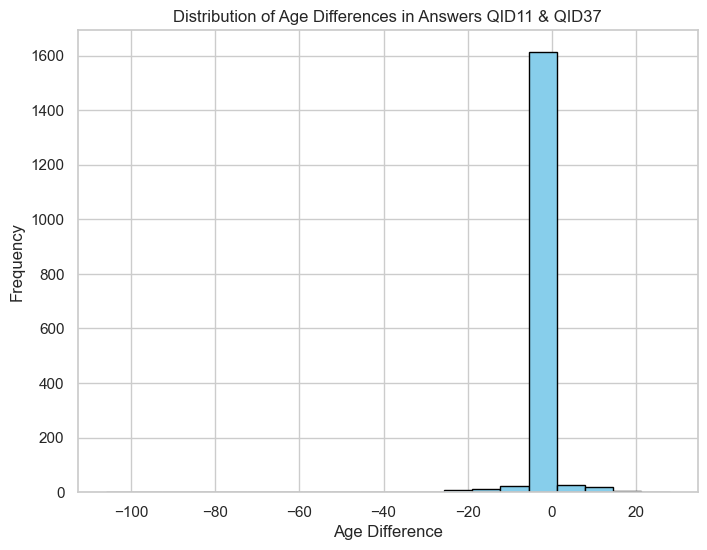

In [77]:
# Plot the age differences
valid_rows = df_profile.dropna(subset=['QID11_answers', 'QID37_age'])

plt.figure(figsize=(8, 6))
plt.hist(valid_rows['age_difference'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Age Differences in Answers QID11 & QID37')
plt.xlabel('Age Difference')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [78]:
print(valid_rows['age_difference'].value_counts())

age_difference
-1.0      1117
 0.0       399
-2.0        41
 1.0        22
-3.0        15
-5.0        11
-6.0        10
 3.0         7
-4.0         7
 6.0         6
 9.0         6
 4.0         5
-15.0        5
 11.0        4
 5.0         4
 2.0         4
-7.0         4
-8.0         3
-14.0        3
 13.0        3
-19.0        3
-20.0        3
 10.0        3
-24.0        2
-10.0        2
 19.0        2
-12.0        2
 20.0        2
-40.0        1
-18.0        1
-90.0        1
-9.0         1
-17.0        1
-21.0        1
 12.0        1
-22.0        1
 26.0        1
-88.0        1
 14.0        1
 28.0        1
-11.0        1
 8.0         1
-48.0        1
-101.0       1
 17.0        1
-57.0        1
-13.0        1
-106.0       1
 21.0        1
Name: count, dtype: int64


In [79]:
count_over_1 = ((valid_rows['age_difference'] > 1) | (valid_rows['age_difference'] < -1)).sum()
print("Number of values with difference greater than 1 or less than -1:", count_over_1)


Number of values with difference greater than 1 or less than -1: 178


In [80]:
# Count NaN values
nan_count = df_profile['age_difference'].isna().sum()
print("Number of NaN values in 'age_difference' column:", nan_count)


Number of NaN values in 'age_difference' column: 2055


In [81]:
# Count NaN values
nan_count = df_profile['QID11_answers'].isna().sum()
print("Number of NaN values in 'age_difference' column:", nan_count)


Number of NaN values in 'age_difference' column: 2055


In [82]:
df_profile['age_difference_more_than_1'] = (df_profile['age_difference'] > 1) | (df_profile['age_difference'] < -1)

# Total
contradictory_age_data = df_profile['age_difference_more_than_1'].sum()
print("Number of rows with age difference more than 1 or less than -1:", contradictory_age_data)


Number of rows with age difference more than 1 or less than -1: 178


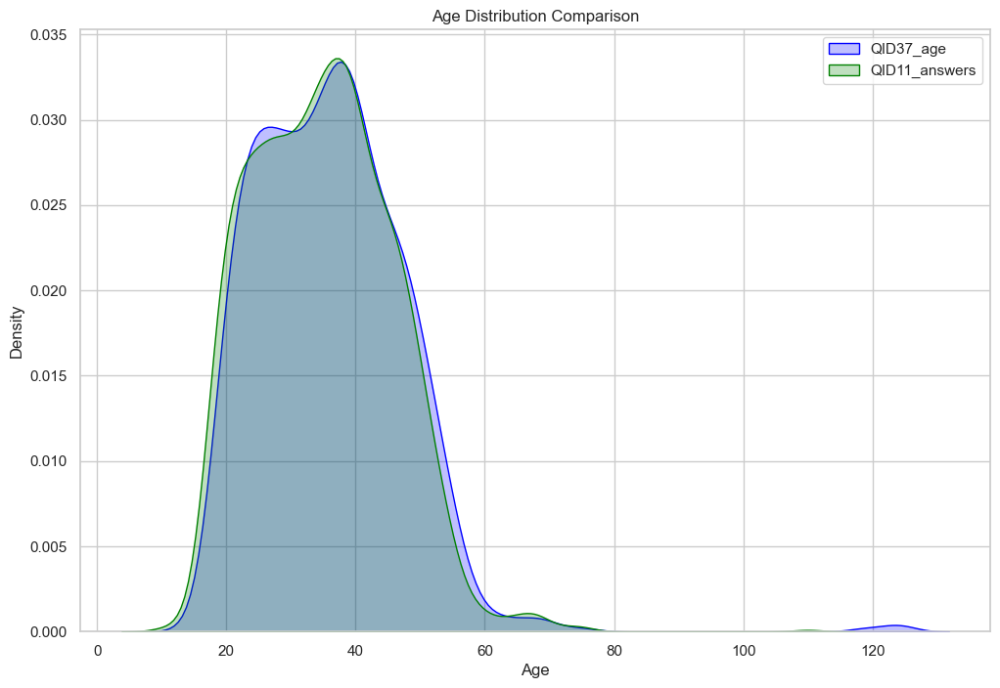

In [83]:
# Define the calculate_age function
def calculate_age(created_at, QID_37_year):
    created_year = pd.to_datetime(created_at).year
    return created_year - QID_37_year

# Replace 'nan' with actual NaN values
df_profile['QID_37_year'] = df_profile['QID_37_year'].replace('nan', np.nan)
df_profile['QID11_answers'] = df_profile['QID11_answers'].replace('nan', np.nan)

# Drop rows with NaN values in specific columns
df_profile = df_profile.dropna(subset=['QID_37_year', 'QID11_answers'])

# Convert to numeric
df_profile['QID_37_year'] = df_profile['QID_37_year'].astype(str).str.strip()
df_profile['QID_37_year'] = pd.to_numeric(df_profile['QID_37_year'], errors='coerce')
df_profile['QID11_answers'] = pd.to_numeric(df_profile['QID11_answers'], errors='coerce')

# Calculate QID37_age
df_profile['QID37_age'] = df_profile.apply(lambda row: calculate_age(row['created_at'], row['QID_37_year']), axis=1)

# Drop rows with NaN values in QID37_age
df_profile = df_profile.dropna(subset=['QID37_age'])

# Ensure 'age' column is present
if 'age' not in df_profile.columns:
    df_profile['age'] = df_profile['QID11_answers']

df_profile['age'] = pd.to_numeric(df_profile['age'], errors='coerce')

# Plot
plt.figure(figsize=(12, 8))

# Plot QID37_age
sns.kdeplot(df_profile['QID37_age'], color='blue', label='QID37_age', fill=True)

# Plot QID11_answers
sns.kdeplot(df_profile['QID11_answers'], color='green', label='QID11_answers', fill=True)

plt.xlabel('Age')
plt.ylabel('Density')
plt.title('Age Distribution Comparison')
plt.legend()
plt.show()


### QID46 - What is your age range?

In [84]:
q46_sample = df_profile.filter(like='QID46').head()  

print("Sample data for columns containing 'QID46':\n", q46_sample)

Sample data for columns containing 'QID46':
    demography_body_labels.QID46       demography_body_labels.QID46_DO  \
1                         25-34  [18-24, 25-34, 35-44, 45-54, 55-100]   
2                         25-34  [18-24, 25-34, 35-44, 45-54, 55-100]   
10                        25-34  [18-24, 25-34, 35-44, 45-54, 55-100]   
18                        35-44  [18-24, 25-34, 35-44, 45-54, 55-100]   
28                        35-44  [18-24, 25-34, 35-44, 45-54, 55-100]   

    demography_body_values.QID46 demography_body_values.QID46_DO  \
1                            2.0                 [1, 2, 3, 4, 5]   
2                            2.0                 [1, 2, 3, 4, 5]   
10                           2.0                 [1, 2, 3, 4, 5]   
18                           3.0                 [1, 2, 3, 4, 5]   
28                           3.0                 [1, 2, 3, 4, 5]   

   demography_body_displayedValues.QID46  
1                        [1, 2, 3, 4, 5]  
2                    

In [85]:
df_profile['QID46_answers'] = df_profile['demography_body_labels.QID46'].astype(str)

print(df_profile['QID46_answers'])

1       25-34
2       25-34
10      25-34
18      35-44
28      35-44
        ...  
4188    18-24
4194    35-44
4211    25-34
4216    35-44
4217    25-34
Name: QID46_answers, Length: 1716, dtype: object


### Birthdate inconsistancies with Age Range

In [86]:
df_profile['age_within_range_QID37'] = (df_profile['QID37_age'] >= df_profile['age_min']) & (df_profile['QID37_age'] <= df_profile['age_max'])
# Check for inconsistencies
birthdate_inconsistent_records = df_profile[~df_profile['age_within_range_QID37']]

print("Birthdate inconsistent records:")
birthdate_inconsistent_records


Birthdate inconsistent records:


,id,user_id,age_min,age_max,gender,created_at,age,country,silvana_answers,eyal_answers_responseId,...,QID11_answers,QID11_age,age_match,QID_37_birthdate,QID_37_year,QID37_age,age_difference,age_difference_more_than_1,QID46_answers,age_within_range_QID37
49,1275,1319684066,35,44,female,2024-03-05 13:29:22.677135,NaN,ukraine,NaN,R_3QzUFyIgPrAiOYx,...,47.0,47,1,5.0-May-1977,1977,47,0.0,False,35-44,False
58,1341,438261621,45,54,male,2024-03-06 15:35:19.195873,NaN,ukraine,NaN,R_5KvuK4X3ArgAwyZ,...,54.0,54,1,6.0-June-1969,1969,55,-1.0,False,45-54,False
146,205,5172734770,25,34,female,2024-01-04 09:51:37.953513,NaN,ukraine,NaN,R_4f0YFSyyr20K3WE,...,37.0,37,1,2.0-February-1985,1985,39,-2.0,True,25-34,False
209,242,925699180,25,34,female,2024-01-11 17:46:28.405182,NaN,ukraine,NaN,R_42mm2GlRYdyxNEl,...,35.0,35,1,1.0-January-1989,1989,35,0.0,False,25-34,False
220,256,691877687,18,24,female,2024-01-11 19:08:19.993167,NaN,ukraine,NaN,R_1rNMPO6z1tI1Exs,...,24.0,24,1,9.0-September-1999,1999,25,-1.0,False,18-24,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3752,2370,651179056,45,54,female,2024-03-18 16:59:28.365753,NaN,ukraine,NaN,R_7fGP6cTtFkshg3R,...,54.0,54,1,6.0-June-1969,1969,55,-1.0,False,45-54,False
3760,3828,1076734175,18,24,female,2024-04-08 22:10:13.95341,NaN,ukraine,NaN,R_2D7FZrKzLGhhv21,...,18.0,18,1,6.0-June-2007,2007,17,1.0,False,18-24,False
3863,2118,866264542,25,34,female,2024-03-15 11:55:57.802433,NaN,ukraine,NaN,R_2S3CLkGG4OlwBZn,...,34.0,34,1,6.0-June-1989,1989,35,-1.0,False,25-34,False
3878,1224,883924305,45,54,male,2024-03-04 11:37:31.124415,NaN,ukraine,NaN,R_3S6vr1Xj4Yb5Dzh,...,54.0,54,1,6.0-June-1969,1969,55,-1.0,False,45-54,False


In [87]:
print("Count of birthdate inconsistent records:", len(birthdate_inconsistent_records))

Count of birthdate inconsistent records: 175


### Age inconsistancies with Age Range

In [88]:
df_profile['QID11_answers'] = pd.to_numeric(df_profile['QID11_answers'], errors='coerce')
df_profile = df_profile.dropna(subset=['QID11_answers'])

# Check if QID11_answers is within the age range
df_profile['age_within_range_QID11'] = (df_profile['QID11_answers'] >= df_profile['age_min']) & (df_profile['QID11_answers'] <= df_profile['age_max'])

inconsistent_records_QID11 = df_profile[~df_profile['age_within_range_QID11']]

inconsistent_records_QID11

,id,user_id,age_min,age_max,gender,created_at,age,country,silvana_answers,eyal_answers_responseId,...,QID11_age,age_match,QID_37_birthdate,QID_37_year,QID37_age,age_difference,age_difference_more_than_1,QID46_answers,age_within_range_QID37,age_within_range_QID11
49,1275,1319684066,35,44,female,2024-03-05 13:29:22.677135,NaN,ukraine,NaN,R_3QzUFyIgPrAiOYx,...,47,1,5.0-May-1977,1977,47,0.0,False,35-44,False,False
146,205,5172734770,25,34,female,2024-01-04 09:51:37.953513,NaN,ukraine,NaN,R_4f0YFSyyr20K3WE,...,37,1,2.0-February-1985,1985,39,-2.0,True,25-34,False,False
195,260,1849996722,18,24,female,2024-01-11 19:51:55.246075,NaN,ukraine,NaN,R_2Q0B7eVYoGaBIRm,...,14,0,8.0-August-2002,2002,22,-8.0,True,18-24,True,False
203,269,763855540,25,34,male,2024-01-12 02:50:43.862201,NaN,ukraine,NaN,R_21YlxLe6sUkJse7,...,20,0,3.0-March-1997,1997,27,-7.0,True,25-34,True,False
209,242,925699180,25,34,female,2024-01-11 17:46:28.405182,NaN,ukraine,NaN,R_42mm2GlRYdyxNEl,...,35,1,1.0-January-1989,1989,35,0.0,False,25-34,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3616,3656,7116006055,35,44,female,2024-04-06 17:20:11.46604,NaN,ukraine,NaN,R_4qkjCgVrIkwQAFj,...,34,1,1.0-January-1975,1975,49,-15.0,True,35-44,False,False
3716,3985,695406513,25,34,female,2024-04-11 10:55:41.786758,NaN,ukraine,NaN,R_24hhPt4mq0aLRRL,...,35,1,9.0-September-1989,1989,35,0.0,False,25-34,False,False
3770,2205,1106685446,25,34,male,2024-03-16 15:05:10.726744,NaN,ukraine,NaN,R_5LLLhxPFj0fhGNC,...,23,0,5.0-May-1996,1996,28,-5.0,True,25-34,True,False
3864,2501,6072456211,18,24,male,2024-03-20 09:52:01.923978,NaN,belgium,NaN,R_5VrrwDirQf36EvT,...,39,0,1.0-January-2006,2006,18,21.0,True,18-24,True,False


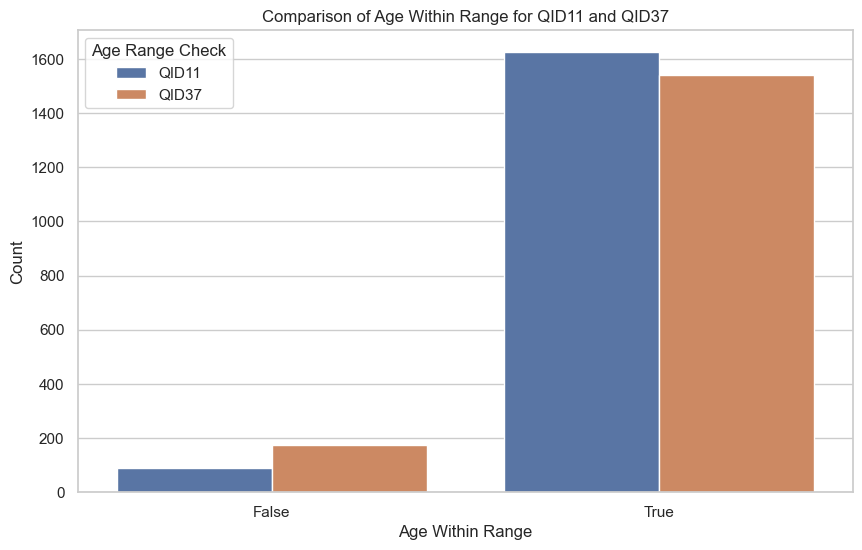

In [89]:
counts_QID11 = df_profile['age_within_range_QID11'].value_counts().sort_index()
counts_QID37 = df_profile['age_within_range_QID37'].value_counts().sort_index()
comparison_df = pd.DataFrame({
    'QID11': counts_QID11,
    'QID37': counts_QID37
}).reset_index().melt(id_vars='index', var_name='Age Range Check', value_name='Count')

# Plot the comparison
plt.figure(figsize=(10, 6))
sns.barplot(data=comparison_df, x='index', y='Count', hue='Age Range Check')
plt.xlabel('Age Within Range')
plt.ylabel('Count')
plt.title('Comparison of Age Within Range for QID11 and QID37')
plt.xticks([0, 1], ['False', 'True'])
plt.legend(title='Age Range Check')
plt.show()

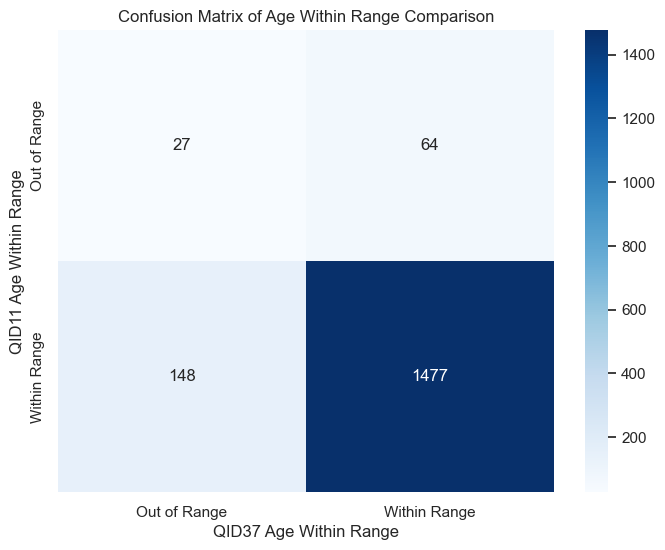

In [90]:
# Plot confusion matrix
conf_matrix = confusion_matrix(df_profile['age_within_range_QID11'], df_profile['age_within_range_QID37'])

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Out of Range', 'Within Range'], yticklabels=['Out of Range', 'Within Range'])
plt.xlabel('QID37 Age Within Range')
plt.ylabel('QID11 Age Within Range')
plt.title('Confusion Matrix of Age Within Range Comparison')
plt.show()

### Profile Age Features for Feature Engineering

In [91]:
df_profile['not_within_range_QID11'] = df_profile['age_within_range_QID11'] == False
df_profile['not_within_range_QID37'] = df_profile['age_within_range_QID37'] == False
df_profile['age_difference_exceeds_1'] = df_profile['age_difference_more_than_1'] == True

age_features = df_profile[['not_within_range_QID11', 'not_within_range_QID37', 'age_difference_exceeds_1']]

print(age_features)

      not_within_range_QID11  not_within_range_QID37  age_difference_exceeds_1
1                      False                   False                     False
2                      False                   False                     False
10                     False                   False                     False
18                     False                   False                     False
28                     False                   False                     False
...                      ...                     ...                       ...
4188                   False                   False                      True
4194                   False                   False                     False
4211                   False                   False                     False
4216                   False                   False                     False
4217                   False                   False                     False

[1716 rows x 3 columns]


In [92]:
df_profile['created_at'] = pd.to_datetime(df_profile['created_at'])
df_users['created_at'] = pd.to_datetime(df_users['created_at'])

# Date range for the bot attack
start_date = '2024-01-13'
end_date = '2024-01-19'

# Filter by the specified date range
df_profile_filtered = df_profile[(df_profile['created_at'] >= start_date) & (df_profile['created_at'] <= end_date)]
df_users_filtered = df_users[(df_users['created_at'] >= start_date) & (df_users['created_at'] <= end_date)]

# Merge 
df_merged = pd.merge(df_profile_filtered, df_users_filtered, on='user_id', how='inner')

# Perform the crosstab operations
print(pd.crosstab(df_merged['isBot'], df_merged['not_within_range_QID11']))
print(pd.crosstab(df_merged['isBot'], df_merged['not_within_range_QID37']))
print(pd.crosstab(df_merged['isBot'], df_merged['age_difference_exceeds_1']))


not_within_range_QID11  False  True 
isBot                               
0.0                         8      6
not_within_range_QID37  False  True 
isBot                               
0.0                        10      4
age_difference_exceeds_1  False  True 
isBot                                 
0.0                           6      8


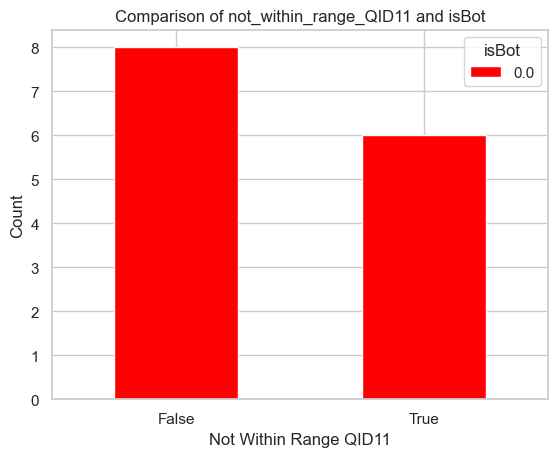

In [93]:
# Crosstab for plotting
ctab = pd.crosstab(df_merged['not_within_range_QID11'], df_merged['isBot'])
ctab.plot(kind='bar', stacked=False, color=['red', 'blue'])
plt.title('Comparison of not_within_range_QID11 and isBot')
plt.xlabel('Not Within Range QID11')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.legend(title='isBot')
plt.show()


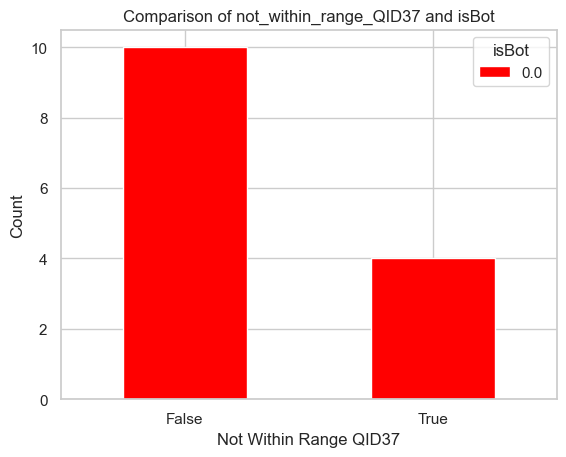

In [94]:
# Crosstab for plotting
ctab = pd.crosstab(df_merged['not_within_range_QID37'], df_merged['isBot'])
ctab.plot(kind='bar', stacked=False, color=['red', 'blue'])
plt.title('Comparison of not_within_range_QID37 and isBot')
plt.xlabel('Not Within Range QID37')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.legend(title='isBot')
plt.show()


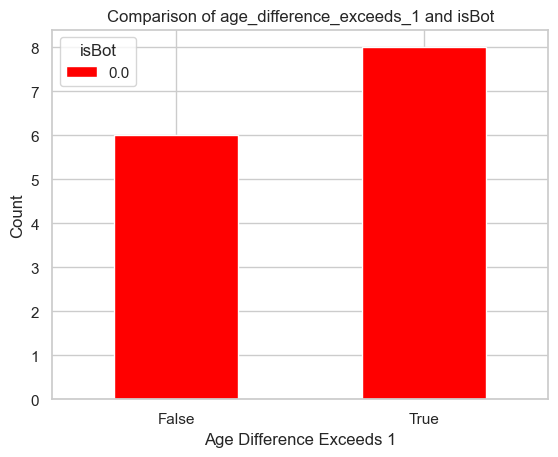

In [95]:
# Crosstab for plotting
ctab = pd.crosstab(df_merged['age_difference_exceeds_1'], df_merged['isBot'])
ctab.plot(kind='bar', stacked=False, color=['red', 'blue'])
plt.title('Comparison of age_difference_exceeds_1 and isBot')
plt.xlabel('Age Difference Exceeds 1')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.legend(title='isBot')
plt.show()


In [96]:
q84_sample = df_profile.filter(like='QID84').head()  

print("Sample data for columns containing 'QID84':\n", q84_sample)

Sample data for columns containing 'QID84':
                        eyal_answers_values.QID84_TEXT
1                         Порахувати кількість людей.
2                                                 NaN
10  Спершу перед мною поставили завдання чітко і ш...
18  Перевірка уважності та сприйняття даного опиту...
28  повідомити про те, що на зображенні немає жодн...


### Inconsistancies in Country residence questions

- df_profile['country']
- dem QID45 - Status of residence
- dem_bot QID47 - Are you in Ukraine now? 
- dem_bot QID15 - Which country are you currently residing?
- eyal_answers QID32 - Country of residence

In [97]:
def check_inconsistencies(row):
    if row['country'] == 'Ukraine':
        # Check if both other answers agree that the user is in Ukraine
        return not (row['QID47'] == True and row['QID15'] == 'Ukraine')
    return False  
df_profile['inconsistency'] = df_profile.apply(check_inconsistencies, axis=1)


In [98]:
qid15_columns = [col for col in df_profile.columns if 'QID47' in col]

print(qid15_columns)

['demography_body_labels.QID47', 'demography_body_labels.QID47_DO', 'demography_body_values.QID47', 'demography_body_values.QID47_DO', 'demography_body_displayedValues.QID47']


In [99]:
# Filter to show only rows with inconsistencies
inconsistent_rows = df_profile[df_profile['inconsistency'] == True]

print(inconsistent_rows)


Empty DataFrame
Columns: [id, user_id, age_min, age_max, gender, created_at, age, country, silvana_answers, eyal_answers_responseId, eyal_answers_displayedFields, eyal_answers_labels.QID3, eyal_answers_labels.QID4, eyal_answers_labels.QID10, eyal_answers_labels.QID11, eyal_answers_labels.QID12, eyal_answers_labels.QID13, eyal_answers_labels.QID29, eyal_answers_labels.QID32, eyal_answers_labels.QID86, eyal_answers_labels.QID140, eyal_answers_labels.QID143, eyal_answers_labels.QID144, eyal_answers_labels.QID145, eyal_answers_labels.QID147, eyal_answers_labels.QID148, eyal_answers_labels.QID149, eyal_answers_labels.QID150, eyal_answers_labels.QID151, eyal_answers_labels.QID7_1, eyal_answers_labels.QID7_2, eyal_answers_labels.QID7_3, eyal_answers_labels.QID7_4, eyal_answers_labels.QID7_5, eyal_answers_labels.QID7_6, eyal_answers_labels.QID7_7, eyal_answers_labels.QID7_8, eyal_answers_labels.QID7_9, eyal_answers_labels.status, eyal_answers_labels.QID3_DO, eyal_answers_labels.QID4_DO, eyal_a

In [100]:
df_profile['demography_body_labels.QID15']

1       Ukraine
2       Ukraine
10      Ukraine
18      Ukraine
28      Ukraine
         ...   
4188    Ukraine
4194    Ukraine
4211    Ukraine
4216    Ukraine
4217    Ukraine
Name: demography_body_labels.QID15, Length: 1716, dtype: object

In [101]:
df_profile['country']

1       ukraine
2       ukraine
10      ukraine
18      ukraine
28      ukraine
         ...   
4188    ukraine
4194    ukraine
4211    ukraine
4216    ukraine
4217    ukraine
Name: country, Length: 1716, dtype: object

In [102]:
df_profile['country'] = df_profile['country'].apply(lambda x: 1 if x == 'ukraine' else 0)

In [103]:
df_profile['country']

1       1
2       1
10      1
18      1
28      1
       ..
4188    1
4194    1
4211    1
4216    1
4217    1
Name: country, Length: 1716, dtype: int64

In [104]:
df_profile['eyal_answers_labels.QID32']

1       Ukraine
2       Ukraine
10      Ukraine
18      Ukraine
28      Ukraine
         ...   
4188    Ukraine
4194    Ukraine
4211    Ukraine
4216    Ukraine
4217    Ukraine
Name: eyal_answers_labels.QID32, Length: 1716, dtype: object

In [105]:
df_profile['eyal_answers_labels.QID32'] = df_profile['eyal_answers_labels.QID32'].fillna('Unknown')

In [106]:
df_profile['eyal_answers_labels.QID32'] = df_profile['eyal_answers_labels.QID32'].apply(lambda x: 1 if x == 'Ukraine' else 0)

In [107]:
df_profile['demography_body_labels.QID45']

1       ​Ukraine_all_the_time
2                    Returned
10      ​Ukraine_all_the_time
18                   Returned
28      ​Ukraine_all_the_time
                ...          
4188    ​Ukraine_all_the_time
4194    ​Ukraine_all_the_time
4211                 Returned
4216    ​Ukraine_all_the_time
4217    ​Ukraine_all_the_time
Name: demography_body_labels.QID45, Length: 1716, dtype: object

In [108]:
df_profile['demography_body_labels.QID45'] = df_profile['demography_body_labels.QID45'].fillna('Unknown')

# Replace specific values
df_profile['demography_body_labels.QID45'] = df_profile['demography_body_labels.QID45'].replace({
    '18-24': 'Unknown',
    '25-34': 'Unknown',
    'before_the_war': 'Before_the_war',
    "don't_live_in_Ukraine": "Don't_live_in_Ukraine",
    'travel_between': 'Travel_between'
})

label_encoder = LabelEncoder()

df_profile['demography_body_labels.QID45_encoded'] = label_encoder.fit_transform(df_profile['demography_body_labels.QID45'])

label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
print("Label mapping:", label_mapping)

print(df_profile[['demography_body_labels.QID45', 'demography_body_labels.QID45_encoded']].head())


Label mapping: {'Before_the_war': 0, "Don't_live_in_Ukraine": 1, 'Returned': 2, 'Travel_between': 3, 'Unknown': 4, '\u200bUkraine_all_the_time': 5}
   demography_body_labels.QID45  demography_body_labels.QID45_encoded
1         ​Ukraine_all_the_time                                     5
2                      Returned                                     2
10        ​Ukraine_all_the_time                                     5
18                     Returned                                     2
28        ​Ukraine_all_the_time                                     5


#5, #2, or #1 will be considered Ukraine as answer.

1 - Don't live in Ukraine
2- Returned 
5 - Ukraine all the time

QID47:

Are you in Ukraine now? 
1 - yes, 0 - no

In [109]:
df_profile['demography_body_labels.QID47'].value_counts()

demography_body_labels.QID47
1    1455
0      17
Name: count, dtype: int64

In [110]:
df_profile['demography_body_labels.QID47'] = df_profile['demography_body_labels.QID47'].fillna('-1')

df_profile['demography_body_labels.QID47'] = df_profile['demography_body_labels.QID47'].replace('18-24', '-1')
df_profile['demography_body_labels.QID47'] = df_profile['demography_body_labels.QID47'].replace('25-34', '-1')

df_profile['demography_body_labels.QID47'] = df_profile['demography_body_labels.QID47'].astype(int)

In [111]:
condition = (
    (df_profile['country'] == 1) &
    (df_profile['eyal_answers_labels.QID32'] == 1) &
    #(df_profile['demography_body_labels.QID45'].isin([2, 3, 5])) & - too ambiguous
    (df_profile['demography_body_labels.QID47'] == 1)
)

df_profile['contradictary_country_answers'] = ~condition

print(df_profile['contradictary_country_answers'].head())

1     False
2     False
10    False
18    False
28    False
Name: contradictary_country_answers, dtype: bool


In [112]:
df_profile['contradictary_country_answers'].value_counts()

contradictary_country_answers
False    1419
True      297
Name: count, dtype: int64

### Contradictory Children Answers
QID25 demo - How many children do you have?

QID30 demo - How many of them are under 18 years old?

In [113]:
df_profile['demography_body_labels.QID25']

1       0
2       2
10      0
18      2
28      2
       ..
4188    0
4194    0
4211    0
4216    0
4217    1
Name: demography_body_labels.QID25, Length: 1716, dtype: object

In [114]:
columns_with_qid30 = [col for col in df_profile.columns if 'QID30' in col]
columns_with_qid30 

['demography_body_labels.QID30',
 'demography_body_labels.QID30_DO',
 'demography_body_values.QID30',
 'demography_body_values.QID30_DO',
 'demography_body_displayedValues.QID30']

In [115]:
df_profile['demography_body_values.QID30']

1       NaN
2       2.0
10      NaN
18      2.0
28      2.0
       ... 
4188    NaN
4194    NaN
4211    NaN
4216    NaN
4217    1.0
Name: demography_body_values.QID30, Length: 1716, dtype: float64

In [116]:
df_profile['demography_body_labels.QID25'] = pd.to_numeric(df_profile['demography_body_labels.QID25'], errors='coerce')
df_profile['demography_body_values.QID30'] = pd.to_numeric(df_profile['demography_body_values.QID30'], errors='coerce')
condition = df_profile['demography_body_labels.QID25'] <= df_profile['demography_body_values.QID30']

df_profile['contradictory_children'] = condition

### Education Questions Inconsistency

QID4 - demography survey - What is the highest level of education you have received?
QID12 - eyal survey - What is the highest level of education you have received?


In [117]:
df_profile['demography_body_labels.QID4'].unique()

array(['Some college', 'Master', 'Bachelor', 'Doctoral', 'High',
       'Vocational', 'Middle', 'Elementary', 'Less than elementary'],
      dtype=object)

In [118]:
columns_with_qid12 = [col for col in df_profile.columns if 'QID12' in col]
columns_with_qid12 

['eyal_answers_labels.QID12',
 'eyal_answers_labels.QID12_DO',
 'eyal_answers_values.QID12',
 'eyal_answers_values.QID12_DO',
 'eyal_answers_values.QID125_LAST_CLICK',
 'eyal_answers_values.QID128_LAST_CLICK',
 'eyal_answers_values.QID125_CLICK_COUNT',
 'eyal_answers_values.QID125_FIRST_CLICK',
 'eyal_answers_values.QID125_PAGE_SUBMIT',
 'eyal_answers_values.QID128_CLICK_COUNT',
 'eyal_answers_values.QID128_FIRST_CLICK',
 'eyal_answers_values.QID128_PAGE_SUBMIT',
 'eyal_answers_displayedValues.QID12']

In [119]:
df_profile['eyal_answers_labels.QID12'].unique()

array(['I prefer not to say', "Bachelor's degree", "Master's degree",
       "Associate's degree", 'Doctoral Degree', 'High school',
       'Some graduate school', 'Other', 'Some high school',
       'Other professional degree'], dtype=object)

In [120]:
demography_mapping = {
    'Some college': 'Some college',
    'Master': "Master's degree",
    'Bachelor': "Bachelor's degree",
    'Doctoral': 'Doctoral Degree',
    'High': 'High school',
    'Vocational': 'Other professional degree',
    'Middle': 'Some high school',
    'Elementary': 'Less than elementary',
    'Less than elementary': 'Less than elementary'
}

# Mapping for eyal_answers_labels.QID12 to the same common category set
eyal_mapping = {
    "I prefer not to say": 'Other',
    "Bachelor's degree": "Bachelor's degree",
    "Master's degree": "Master's degree",
    "Associate's degree": 'Some college',
    'Doctoral Degree': 'Doctoral Degree',
    'High school': 'High school',
    'Some graduate school': 'Other',
    'Other': 'Other',
    'Some high school': 'Some high school',
    'Other professional degree': 'Other professional degree'
}

# Apply the mappings to create new encoded columns
df_profile['demography_encoded'] = df_profile['demography_body_labels.QID4'].map(demography_mapping)
df_profile['eyal_encoded'] = df_profile['eyal_answers_labels.QID12'].map(eyal_mapping)

print(df_profile)

        id     user_id  age_min  age_max  gender                 created_at  \
1      960  1047000229       25       34    male 2024-02-28 09:31:13.869523   
2      908   865654491       25       34  female 2024-02-27 12:03:40.726419   
10    1194  1542534728       25       34    male 2024-03-03 20:50:56.933484   
18    1217  1402755430       35       44    male 2024-03-04 10:30:05.339370   
28    1263  2057138474       35       44  female 2024-03-05 07:38:30.875842   
...    ...         ...      ...      ...     ...                        ...   
4188  2921  1399951263       18       24  female 2024-03-27 10:47:58.195352   
4194  3265   465487494       35       44  female 2024-04-01 07:03:56.154640   
4211  2356   416926109       25       34  female 2024-03-18 14:29:58.611944   
4216  1884  6025765548       35       44  female 2024-03-13 11:01:45.183194   
4217  3566   270090273       25       34  female 2024-04-05 16:56:29.670213   

      age  country silvana_answers eyal_answers_res

In [121]:
df_profile['education_mismatch'] = (df_profile['demography_encoded'] != df_profile['eyal_encoded']).astype(int)


In [122]:
df_profile['education_mismatch']

1       1
2       1
10      0
18      0
28      0
       ..
4188    1
4194    1
4211    0
4216    0
4217    0
Name: education_mismatch, Length: 1716, dtype: int64

### Bot responses to QID11 - OLD

In [123]:
df_profile['QID11_answers'] = ''

# Iterate over DataFrame columns
for col in df_profile.columns:
    # Check if column name contains 'QID11'
    if 'QID11' in col:
        # Extract values from the column
        df_profile['QID11_answers'] = df_profile['QID11_answers'].fillna('') + df_profile[col].astype(str) + ' '

# Remove leading and trailing whitespaces
df_profile['QID11_answers'] = df_profile['QID11_answers'].str.strip()

print(df_profile['QID11_answers'])


1       33 ['10', '11', '12', '13', '14', '15', '16', ...
2       30 ['10', '11', '12', '13', '14', '15', '16', ...
10      25 ['10', '11', '12', '13', '14', '15', '16', ...
18      36 ['10', '11', '12', '13', '14', '15', '16', ...
28      37 ['10', '11', '12', '13', '14', '15', '16', ...
                              ...                        
4188    24 ['10', '11', '12', '13', '14', '15', '16', ...
4194    35 ['10', '11', '12', '13', '14', '15', '16', ...
4211    27 ['10', '11', '12', '13', '14', '15', '16', ...
4216    37 ['10', '11', '12', '13', '14', '15', '16', ...
4217    28 ['10', '11', '12', '13', '14', '15', '16', ...
Name: QID11_answers, Length: 1716, dtype: object


In [124]:
merged_df = pd.merge(df_profile, df_users, on='id', how='inner')

In [125]:
merged_df.head(20)

,id,user_id_x,age_min,age_max,gender,created_at_x,age,country,silvana_answers,eyal_answers_responseId,...,data_fraud_referral_ancestor_edfad5f1-79c1-465c-b9fa-4f3d17602d72,data_fraud_referral_ancestor_f3378a72-aff1-4a1c-9872-539137a273db,data_fraud_referral_ancestor_f5dcb06f-1130-4768-9150-22354da41c19,data_fraud_referral_ancestor_f7de1064-8c12-4fa1-adde-6925fbd0f016,data_fraud_referral_ancestor_fab5e967-86af-497b-a2fc-e73a79c703fe,data_fraud_referral_ancestor_feb67a49-b7d0-4946-9024-daeef24b7878,repeated_ip,high_referral_ancestor,campaign_is_ad,high_referral_ancestor_encoded
0,908,865654491,25,34,female,2024-02-27 12:03:40.726419,NaN,1,NaN,R_4PdFKKPOPX5fN3H,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,0
1,205,5172734770,25,34,female,2024-01-04 09:51:37.953513,NaN,1,NaN,R_4f0YFSyyr20K3WE,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
2,196,5233085166,55,100,female,2023-12-26 14:42:42.327903,NaN,0,NaN,R_5OJCT6nwkvBzE45,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
3,203,6636130236,55,100,female,2023-12-31 11:37:23.225419,NaN,1,NaN,R_2UDUwvq6WXDhXY5,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
4,187,326315566,35,44,male,2023-12-25 14:16:04.599471,NaN,1,NaN,R_6rJEc4LuShfsCRM,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
5,228,559865495,18,24,female,2024-01-11 17:04:38.299180,NaN,0,NaN,R_2aeNehUxlsKqa61,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
6,260,1849996722,18,24,female,2024-01-11 19:51:55.246075,NaN,1,NaN,R_2Q0B7eVYoGaBIRm,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
7,245,1732773901,25,34,female,2024-01-11 17:48:13.713581,NaN,1,NaN,R_8AMTMs8NWRTzauQ,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
8,278,597979019,45,54,чоловік,2024-01-12 08:38:07.072744,NaN,1,NaN,R_24gTIvXPYVTGDi9,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1
9,219,1118330236,45,54,male,2024-01-09 08:59:55.588213,NaN,1,NaN,R_4lbmzome34ZqD09,...,0.0,0.0,0.0,0.0,0.0,0.0,True,True,NaN,1


In [126]:
bot_responses_t = merged_df[merged_df['isBot'] == 1.0]

if bot_responses_t.empty:
    print("No rows found where isBot is '1.0'.")
else:
    # Get the columns that contain 'QID10' in their names
    qid10_columns = [col for col in merged_df.columns if 'QID10' in col]

    # Check if there are no columns containing 'QID10'
    if not qid10_columns:
        print("No columns found containing 'QID10'.")
    else:
        # Iterate over rows where isBot is 't'
        for index, row in bot_responses_t[qid10_columns].iterrows():
            print(row.values)



No rows found where isBot is '1.0'.


In [127]:
bot_responses_t = merged_df[merged_df['isBot'] == 1.0]

if bot_responses_t.empty:
    print("No rows found where isBot is '1.0'.")
else:
    # Get the columns that contain 'QID11' in their names
    qid10_columns = [col for col in merged_df.columns if 'QID11' in col]

    # Check if there are no columns containing 'QID11'
    if not qid10_columns:
        print("No columns found containing 'QID11'.")
    else:
        for index, row in bot_responses_t[qid10_columns].iterrows():
            print(row.values)


No rows found where isBot is '1.0'.


In [128]:
bot_responses_t = merged_df[merged_df['isBot'] == 1.0]

if bot_responses_t.empty:
    print("No rows found where isBot is '1.0'.")
else:
    qid10_columns = [col for col in merged_df.columns if 'QID10' in col]

    if not qid10_columns:
        print("No columns found containing 'QID10'.")
    else:
          for index, row in bot_responses_t[qid10_columns].iterrows():
            print(row.values)


No rows found where isBot is '1.0'.


### Qualtrics Tracker

In [131]:
df_qualtrics_tracker = pd.read_csv('qualtrics_tracker.csv')
df_qualtrics_tracker.head()

,id,uuid,data,created_at
0,1,84b0e3ac-320d-46d9-bffd-adaf431e0210,"[{""type"": ""click"", ""tagName"": ""LABEL"", ""timest...",17:49:50.167487
1,2,84b0e3ac-320d-46d9-bffd-adaf431e0210,"[{""type"": ""click"", ""tagName"": ""SELECT"", ""times...",17:50:00.831716
2,3,e8c5337f-4f0f-4f45-860f-179d7949186b,"[{""type"": ""click"", ""tagName"": ""TEXTAREA"", ""tim...",17:50:10.542788
3,4,84b0e3ac-320d-46d9-bffd-adaf431e0210,"[{""type"": ""listSelection"", ""tagName"": ""SELECT""...",17:50:12.126048
4,5,84b0e3ac-320d-46d9-bffd-adaf431e0210,"[{""type"": ""click"", ""tagName"": ""SPAN"", ""timesta...",17:50:53.165328


In [132]:
df_qualtrics_tracker['data'] = df_qualtrics_tracker['data'].apply(json.loads)

df = df_qualtrics_tracker.explode('data')

normalized_qualtrics_df = json_normalize(df['data'])

normalized_qualtrics_df['id'] = df['id'].values
normalized_qualtrics_df['uuid'] = df['uuid'].values
normalized_qualtrics_df['created_at'] = df['created_at'].values


In [133]:
normalized_qualtrics_df.head()

,type,tagName,timestamp,uniqueIdentifier,targetDetails.id,targetDetails.classes,targetDetails.tagName,targetDetails.attributes.id,targetDetails.attributes.for,targetDetails.attributes.class,...,targetDetails.attributes.target,targetDetails.attributes.page-id,targetDetails.attributes.data-runtime-hide,targetDetails.attributes.data-runtime-disabled,targetDetails.attributes.data-runtime-aria-label,targetDetails.attributes.data-runtime-html,targetDetails.attributes.data-runtime-show,id,uuid,created_at
0,click,LABEL,2024-03-25T17:49:43.719Z,84b0e3ac-320d-46d9-bffd-adaf431e0210,QID1-9-label,"[SingleAnswer, ChoiceTextPositionLeft]",LABEL,QID1-9-label,QR~QID1~9,SingleAnswer ChoiceTextPositionLeft,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,84b0e3ac-320d-46d9-bffd-adaf431e0210,17:49:50.167487
1,click,INPUT,2024-03-25T17:49:43.720Z,84b0e3ac-320d-46d9-bffd-adaf431e0210,QR~QID1~9,"[radio, QR-QID1-9, QWatchTimer]",INPUT,QR~QID1~9,NaN,radio QR-QID1-9 QWatchTimer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,84b0e3ac-320d-46d9-bffd-adaf431e0210,17:49:50.167487
2,listSelection,INPUT,2024-03-25T17:49:43.721Z,84b0e3ac-320d-46d9-bffd-adaf431e0210,QR~QID1~9,"[radio, QR-QID1-9, QWatchTimer]",INPUT,QR~QID1~9,NaN,radio QR-QID1-9 QWatchTimer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,84b0e3ac-320d-46d9-bffd-adaf431e0210,17:49:50.167487
3,click,SELECT,2024-03-25T17:49:54.608Z,84b0e3ac-320d-46d9-bffd-adaf431e0210,QR~QID15,"[ChoiceStructure, Selection, LargeSelection, Q...",SELECT,QR~QID15,NaN,ChoiceStructure Selection LargeSelection QR-QI...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2,84b0e3ac-320d-46d9-bffd-adaf431e0210,17:50:00.831716
4,click,TEXTAREA,2024-03-25T17:50:05.733Z,e8c5337f-4f0f-4f45-860f-179d7949186b,QR~QID31,"[InputText, QR-QID31, QWatchTimer]",TEXTAREA,QR~QID31,NaN,InputText QR-QID31 QWatchTimer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,e8c5337f-4f0f-4f45-860f-179d7949186b,17:50:10.542788


In [134]:
qualtrics_profile = ProfileReport(normalized_qualtrics_df, title="Qualtrics Profiling Report")
qualtrics_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [135]:
with pd.option_context('display.max_columns', None):
    print(df_users.columns)

Index(['id', 'user_id', 'status', 'created_at', 'balance', 'uuid',
       'pined_msg_id', 'came_from', 'lang', 'jira_task',
       ...
       'data_fraud_referral_ancestor_edfad5f1-79c1-465c-b9fa-4f3d17602d72',
       'data_fraud_referral_ancestor_f3378a72-aff1-4a1c-9872-539137a273db',
       'data_fraud_referral_ancestor_f5dcb06f-1130-4768-9150-22354da41c19',
       'data_fraud_referral_ancestor_f7de1064-8c12-4fa1-adde-6925fbd0f016',
       'data_fraud_referral_ancestor_fab5e967-86af-497b-a2fc-e73a79c703fe',
       'data_fraud_referral_ancestor_feb67a49-b7d0-4946-9024-daeef24b7878',
       'repeated_ip', 'high_referral_ancestor', 'campaign_is_ad',
       'high_referral_ancestor_encoded'],
      dtype='object', length=107)


In [136]:
# Identify referral ancestor columns
referral_ancestor_columns = [col for col in df_users.columns if 'referral_ancestor' in col]
print(f"Identified referral ancestor columns: {referral_ancestor_columns}")

# Melt the dataframe to combine referral ancestor columns into one
df_referral_ancestors = df_users.melt(id_vars=['user_id'], value_vars=referral_ancestor_columns, var_name='referral_ancestor_type', value_name='referral_ancestor')

# Display the melted dataframe before dropping NaNs
print("Melted dataframe (before dropping NaNs):")
print(df_referral_ancestors.head())

# Drop rows with NaN values in the referral_ancestor column
df_referral_ancestors = df_referral_ancestors.dropna(subset=['referral_ancestor'])

# Drop the referral_ancestor_type column as it's no longer needed
df_referral_ancestors = df_referral_ancestors.drop(columns=['referral_ancestor_type'])

# Display the result
print("Dataframe after processing:")
print(df_referral_ancestors.head())

# Count occurrences of each referral ancestor
referral_ancestor_counts = df_referral_ancestors['referral_ancestor'].value_counts()

print("Referral ancestor counts:")
print(referral_ancestor_counts)


Identified referral ancestor columns: ['data_fraud_referral_ancestor', 'data_fraud_referral_ancestor_05398c9e-9966-431d-a7d9-07106e94d5eb', 'data_fraud_referral_ancestor_099f7832-af51-4ca8-8f7c-236d46cfbfdd', 'data_fraud_referral_ancestor_0b9f3807-64e0-4d25-bead-5b318b7e73d0', 'data_fraud_referral_ancestor_103ce83e-9989-4642-a070-c96548e56f2a', 'data_fraud_referral_ancestor_14e96e32-5b6c-4cae-ae03-351e52074b24', 'data_fraud_referral_ancestor_1ae81d15-86f7-42b6-8bef-6856d117379b', 'data_fraud_referral_ancestor_1f823ed6-bdc8-4bf0-a68d-7e7880f7aa50', 'data_fraud_referral_ancestor_26c6a871-5756-4d39-a7ec-2a9a7a3b53ba', 'data_fraud_referral_ancestor_2a39aef3-5b30-4e96-b2dc-a6ca3ced2a75', 'data_fraud_referral_ancestor_2f299dfa-dde9-40be-a2bc-b3673b7d728f', 'data_fraud_referral_ancestor_38d8b7f8-0372-43f7-aaa5-ae2f829a8811', 'data_fraud_referral_ancestor_3e1a6524-2b3c-4d83-b9ee-850ac244aa16', 'data_fraud_referral_ancestor_3efdf716-4e5f-4f6d-9e82-f0cdc6791b4f', 'data_fraud_referral_ancestor_41

In [137]:
users_event_log_df = df_users_event_log[user_event_log_columns]
users_event_log_df.columns

Index(['user_id', 'event', 'recaptcha_score', 'proxy_used'], dtype='object')

In [138]:
df_profile.columns

Index(['id', 'user_id', 'age_min', 'age_max', 'gender', 'created_at', 'age',
       'country', 'silvana_answers', 'eyal_answers_responseId',
       ...
       'not_within_range_QID11', 'not_within_range_QID37',
       'age_difference_exceeds_1', 'inconsistency',
       'demography_body_labels.QID45_encoded', 'contradictary_country_answers',
       'contradictory_children', 'demography_encoded', 'eyal_encoded',
       'education_mismatch'],
      dtype='object', length=471)

## Data Comparison: Pre vs. Post Attack <a id=8></a>

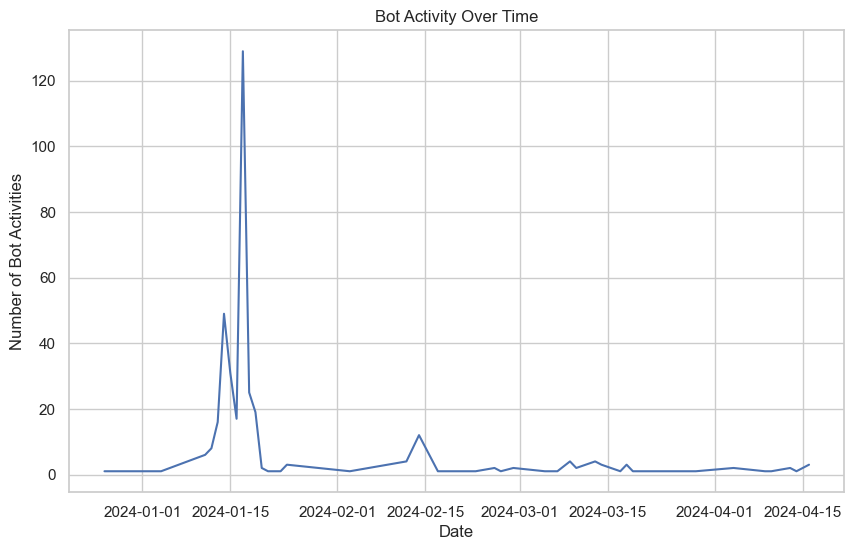

In [139]:

bot_activity_over_time = df_bots.groupby(df_bots['created_at'].dt.date).size()

plt.figure(figsize=(10, 6))
bot_activity_over_time.plot(kind='line')
plt.title('Bot Activity Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Bot Activities')
plt.grid(True)
plt.show()

In [140]:
from scipy.stats import ttest_ind, chi2_contingency
df_users['created_at'] = pd.to_datetime(df_users['created_at'])

# "before" and "after" the bot attack
attack_start = '2024-01-15'
attack_end = '2024-01-20'

before_attack = df_users[df_users['created_at'] < attack_start]
after_attack = df_users[df_users['created_at'] >= attack_start]

columns_to_compare = [col for col in df_users.columns if col not in ['created_at', 'isBot']]

results = {}

def is_numerical(column):
    return pd.api.types.is_numeric_dtype(column)

# Compare each column
for column in columns_to_compare:
    # Check if the column is numerical or categorical
    if is_numerical(df_users[column]):
        # Convert the column to numeric, forcing errors to NaN
        before_attack[column] = pd.to_numeric(before_attack[column], errors='coerce')
        after_attack[column] = pd.to_numeric(after_attack[column], errors='coerce')
        
        # Perform a t-test for numerical columns
        try:
            t_stat, p_value = ttest_ind(before_attack[column].dropna(), after_attack[column].dropna())
            results[column] = {'test': 't-test', 't_stat': t_stat, 'p_value': p_value}
        except ValueError as e:
            results[column] = {'test': 't-test', 'error': str(e)}
    else:
        # Perform a chi-square test for categorical columns
        try:
            contingency_table = pd.crosstab(before_attack[column].dropna(), after_attack[column].dropna())
            chi2, p_value, _, _ = chi2_contingency(contingency_table)
            results[column] = {'test': 'chi2-test', 'chi2': chi2, 'p_value': p_value}
        except ValueError as e:
            results[column] = {'test': 'chi2-test', 'error': str(e)}

results_df = pd.DataFrame(results).T

results_df.reset_index(inplace=True)
results_df.columns = ['Column', 'Test', 'Statistic', 'P-Value', 'Error']
print(results_df)


                                                Column       Test  Statistic  \
0                                                   id     t-test -10.454679   
1                                              user_id     t-test  -7.560641   
2                                               status  chi2-test        NaN   
3                                              balance     t-test  -1.042441   
4                                                 uuid  chi2-test        NaN   
..                                                 ...        ...        ...   
100  data_fraud_referral_ancestor_feb67a49-b7d0-494...     t-test  -0.697062   
101                                        repeated_ip     t-test        NaN   
102                             high_referral_ancestor     t-test   2.290174   
103                                     campaign_is_ad  chi2-test        NaN   
104                     high_referral_ancestor_encoded     t-test   2.571873   

      P-Value                          

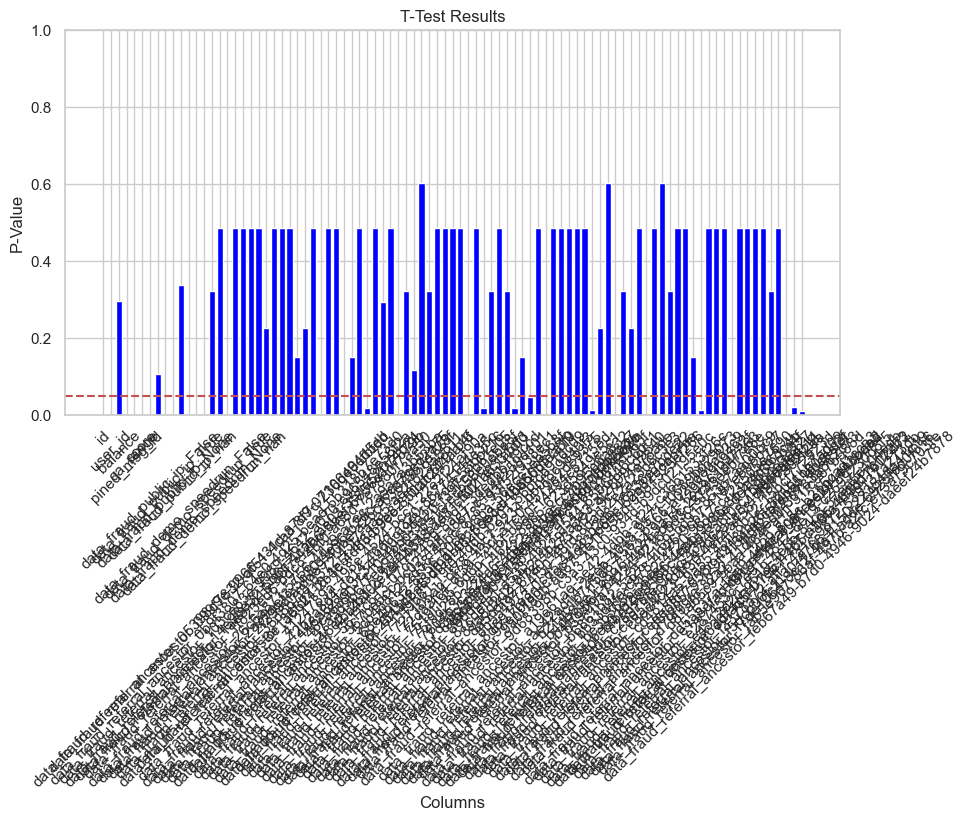

In [141]:
t_test_results = results_df[results_df['Test'] == 't-test']
chi2_test_results = results_df[results_df['Test'] == 'chi2-test']

# Plot t-test results
plt.figure(figsize=(10, 5))
plt.bar(t_test_results['Column'], t_test_results['P-Value'], color='blue')
plt.axhline(y=0.05, color='r', linestyle='--')
plt.xlabel('Columns')
plt.ylabel('P-Value')
plt.title('T-Test Results')
plt.xticks(rotation=45)
plt.ylim(0, 1)
plt.show()


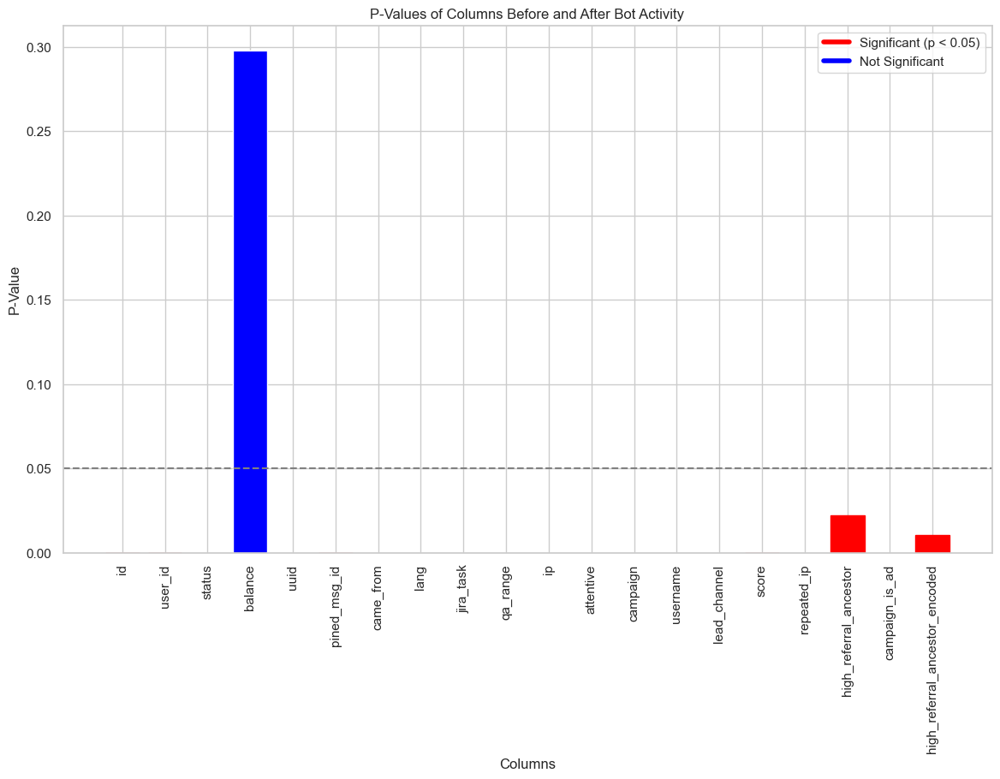

In [142]:
results_df = pd.DataFrame(results).T

results_df['p_value'] = results_df['p_value'].astype(float)

# Exclude columns with 'fraud'
results_df_filtered = results_df[~results_df.index.str.contains('fraud')]

# Create a plot
plt.figure(figsize=(14, 8))
plt.bar(results_df_filtered.index, results_df_filtered['p_value'], color='blue')

for idx, p_value in enumerate(results_df_filtered['p_value']):
    if p_value < 0.05:
        plt.gca().get_children()[idx].set_color('red')

plt.axhline(y=0.05, color='gray', linestyle='--')
plt.xticks(rotation=90)
plt.xlabel('Columns')
plt.ylabel('P-Value')
plt.title('P-Values of Columns Before and After Bot Activity')

red_patch = plt.Line2D([0], [0], color='red', lw=4, label='Significant (p < 0.05)')
blue_patch = plt.Line2D([0], [0], color='blue', lw=4, label='Not Significant')
plt.legend(handles=[red_patch, blue_patch])

plt.show()

In [143]:
significant_columns_df = results_df[results_df['p_value'] < 0.05]

significant_columns = significant_columns_df.index.tolist()

significant_columns

['id',
 'user_id',
 'pined_msg_id',
 'score',
 'data_fraud_public_ip_False',
 'data_fraud_public_ip_None',
 'data_fraud_demo_speedrun_True',
 'data_fraud_demo_speedrun_None',
 'data_fraud_referral_ancestor_0b9f3807-64e0-4d25-bead-5b318b7e73d0',
 'data_fraud_referral_ancestor_42b2a8d4-dc14-46d0-a320-86774144e35c',
 'data_fraud_referral_ancestor_47a3d9b6-7ee9-4c63-b51c-ecb56e0ebe8f',
 'data_fraud_referral_ancestor_5611c613-07cf-4489-8a91-3dedbb1f9ccd',
 'data_fraud_referral_ancestor_6c2511d2-43d0-4b05-8ce3-d40a66537a10',
 'data_fraud_referral_ancestor_815c3170-3cf1-407f-b9f6-bdc1083b5b2b',
 'data_fraud_referral_ancestor_87cdefa1-a533-4b27-a544-6506446c6bc1',
 'data_fraud_referral_ancestor_8d6911e3-0cd5-41a8-b2d8-16536e7bde22',
 'data_fraud_referral_ancestor_9a0f180b-ad87-4e1f-95bd-9581525ef266',
 'data_fraud_referral_ancestor_b594f9a7-f224-4216-bd3c-8743eebf7e8e',
 'data_fraud_referral_ancestor_be3b3656-5ba2-4720-9617-c725505e7690',
 'data_fraud_referral_ancestor_c80530f0-fd18-47b6-ace8-

## Feature Selection <a id=9></a>

In [144]:
#Relevant columns from each dataset
columns_to_keep_from_users = [
    'user_id', 'ip', 'status', 'created_at', 'attentive', 'balance',
    'pined_msg_id', 'came_from', 'jira_task', 'isBot',
    'repeated_ip', 'high_referral_ancestor_encoded',
    'data_fraud_referral_ancestor', 'data_fraud_public_ip', 'data_fraud_demo_speedrun']  
columns_to_keep_from_profile = [
    'user_id', 'QID11_age', 'country', 'fraud_score', 'contradictary_country_answers',
    'demography_body_values.duration','eyal_answers_values.duration', 'education_mismatch', 'not_within_range_QID11', 
    'not_within_range_QID37', 'age_difference_exceeds_1', 'contradictory_children']
columns_to_keep_from_uel = ['user_id', 'event', 'recaptcha_score', 'proxy_used']

df_profile_selected = df_profile[columns_to_keep_from_profile]
df_users_selected = df_users[columns_to_keep_from_users]
df_uel_selected = df_users_event_log[columns_to_keep_from_uel]

df_merged = pd.merge(df_profile_selected, df_users_selected, on='user_id', how='inner')

df_merged = pd.merge(df_merged, df_uel_selected, on='user_id', how='inner')

print(df_merged.head())


      user_id  QID11_age  country  fraud_score  contradictary_country_answers  \
0  1542534728         25        1          NaN                          False   
1  1542534728         25        1          NaN                          False   
2  1542534728         25        1          NaN                          False   
3   499580386         41        1          0.0                          False   
4   499580386         41        1          0.0                          False   

   demography_body_values.duration  eyal_answers_values.duration  \
0                              319                         452.0   
1                              319                         452.0   
2                              319                         452.0   
3                              510                        1098.0   
4                              510                        1098.0   

   education_mismatch  not_within_range_QID11  not_within_range_QID37  ...  \
0                   0     

Thoughts:
aws anti fraud solution/detector - https://aws.amazon.com/fraud-detector/
- prevention
- isolation forest
- https://huggingface.co/docs/hub/en/model-cards

In [145]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 358 entries, 0 to 357
Data columns (total 29 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   user_id                          358 non-null    int64         
 1   QID11_age                        358 non-null    Int64         
 2   country                          358 non-null    int64         
 3   fraud_score                      218 non-null    float64       
 4   contradictary_country_answers    358 non-null    bool          
 5   demography_body_values.duration  358 non-null    int64         
 6   eyal_answers_values.duration     358 non-null    float64       
 7   education_mismatch               358 non-null    int64         
 8   not_within_range_QID11           358 non-null    bool          
 9   not_within_range_QID37           358 non-null    bool          
 10  age_difference_exceeds_1         358 non-null    bool         

## Column Conditions <a id=10></a>

### IP Addresses 

Addresses with 5 or more **ip_counts**, as well as those found **True** in the 
**data_fraud_public_ips**


In [146]:
# IP Addresss
ip_counts = df_merged['ip'].value_counts()
frequent_ips = ip_counts[ip_counts > 10].index

In [147]:
df_merged['isBot_frequent_ip'] = df_merged['ip'].isin(frequent_ips).astype(int)

In [148]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')
df_merged['data_fraud_public_ip'] = encoder.fit_transform(df_merged[['data_fraud_public_ip']])


In [149]:
df_merged['data_fraud_public_ip']

0      0.0
1      0.0
2      0.0
3      1.0
4      1.0
      ... 
353    1.0
354    1.0
355    1.0
356    1.0
357    1.0
Name: data_fraud_public_ip, Length: 358, dtype: float64

In [150]:
df_merged['isBot_public_ip'] = (df_merged['data_fraud_public_ip'] == 1.0).astype(int)

### Balances
Upper outliers of Balance - will not use as not enough evidnece for outliers 

In [151]:
df_merged['balance'].describe()

count    358.000000
mean      69.134078
std       50.987272
min        0.000000
25%       32.000000
50%       52.000000
75%      110.000000
max      208.000000
Name: balance, dtype: float64

In [152]:
Q3 = df_merged['balance'].quantile(0.75)

print(f"75th percentile (Q3): {Q3}")

df_merged['isBot_balances'] = df_merged['balance'].apply(lambda x: 1 if x > Q3 else 0)

75th percentile (Q3): 110.0


In [153]:
print(df_merged['isBot_balances'].value_counts())

isBot_balances
0    290
1     68
Name: count, dtype: int64


### Fraud Score
Fraud score is unusually high

In [154]:
df_merged['fraud_score']

0       NaN
1       NaN
2       NaN
3       0.0
4       0.0
       ... 
353     0.0
354    75.0
355    75.0
356     0.0
357     0.0
Name: fraud_score, Length: 358, dtype: float64

In [155]:
Q1 = df_merged['fraud_score'].quantile(0.25)
Q3 = df_merged['fraud_score'].quantile(0.75)
IQR = Q3 - Q1

# Define outliers
upper_bound = Q3 + 1.5 * IQR

df_merged['isBot_score'] = df_merged['fraud_score'].apply(lambda x: 1 if x > upper_bound else 0)

df_merged['isBot_score'].value_counts()

isBot_score
0    319
1     39
Name: count, dtype: int64

### Speedrun and Duration
Speedrun is True and Duration is an outlier

In [156]:
df_merged['demography_body_values.duration'].describe()

count     358.000000
mean      518.818436
std       214.141967
min       143.000000
25%       352.000000
50%       495.000000
75%       658.000000
max      1118.000000
Name: demography_body_values.duration, dtype: float64

In [157]:
Q1 = df_merged['demography_body_values.duration'].quantile(0.25)
Q3 = df_merged['demography_body_values.duration'].quantile(0.75)
IQR = Q3 - Q1

# Define outliers
upper_bound = Q3 + 1.5 * IQR

df_merged['isBot_duration'] = df_merged['demography_body_values.duration'].apply(lambda x: 1 if x > upper_bound else 0)

print(df_merged['isBot_duration'].sum())

3


In [158]:
df_merged['isBot_speedrun']= df_merged['data_fraud_demo_speedrun'] == True
df_merged['isBot_speedrun']= df_merged['isBot_speedrun'].astype(int)

df_merged['isBot_speedrun']

0      0
1      0
2      0
3      0
4      0
      ..
353    0
354    0
355    0
356    0
357    0
Name: isBot_speedrun, Length: 358, dtype: int64

### Referral Ancestor
Repeated referral ancestor

In [159]:
(df_merged['high_referral_ancestor_encoded']==1).sum()


237

### Age
More than 100, or less than 18

In [160]:
df_merged['isBot_age'] = (df_merged['QID11_age'] < 18) | (df_merged['QID11_age'] > 100)


### Survey Answer Inconsistancies

In [161]:
'contradictary_country_answers'
'not_within_range_QID11', 
'not_within_range_QID37',
'age_difference_exceeds_1', 
'contradictory_children',
'education_mismatch'

df_merged['age_survey_contradictions'] = (
    (df_merged['not_within_range_QID11']==True) &
    (df_merged['not_within_range_QID37']==True) &
    (df_merged['age_difference_exceeds_1']==True) 
)


### Recaptcha Score

In [162]:
Q1 = df_merged['recaptcha_score'].quantile(0.25)
Q3 = df_merged['recaptcha_score'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

df_merged['isBot_recaptcha'] = df_merged['recaptcha_score'].apply(lambda x: 1 if x < lower_bound or x > upper_bound else 0)

print(df_merged)

        user_id  QID11_age  country  fraud_score  \
0    1542534728         25        1          NaN   
1    1542534728         25        1          NaN   
2    1542534728         25        1          NaN   
3     499580386         41        1          0.0   
4     499580386         41        1          0.0   
..          ...        ...      ...          ...   
353   629411694         27        1          0.0   
354   382935788         25        1         75.0   
355   382935788         25        1         75.0   
356  5529014442         27        0          0.0   
357  5529014442         27        0          0.0   

     contradictary_country_answers  demography_body_values.duration  \
0                            False                              319   
1                            False                              319   
2                            False                              319   
3                            False                              510   
4                   

In [163]:
print(df_merged)

        user_id  QID11_age  country  fraud_score  \
0    1542534728         25        1          NaN   
1    1542534728         25        1          NaN   
2    1542534728         25        1          NaN   
3     499580386         41        1          0.0   
4     499580386         41        1          0.0   
..          ...        ...      ...          ...   
353   629411694         27        1          0.0   
354   382935788         25        1         75.0   
355   382935788         25        1         75.0   
356  5529014442         27        0          0.0   
357  5529014442         27        0          0.0   

     contradictary_country_answers  demography_body_values.duration  \
0                            False                              319   
1                            False                              319   
2                            False                              319   
3                            False                              510   
4                   

In [164]:
columns_to_encode = [
    'age_survey_contradictions',
    'not_within_range_QID11', 
    'not_within_range_QID37',
    'age_difference_exceeds_1', 
    'contradictory_children',
    'education_mismatch',
    'contradictary_country_answers'
]

for col in columns_to_encode:
    df_merged[col] = df_merged[col].astype(int)

print(df_merged)

        user_id  QID11_age  country  fraud_score  \
0    1542534728         25        1          NaN   
1    1542534728         25        1          NaN   
2    1542534728         25        1          NaN   
3     499580386         41        1          0.0   
4     499580386         41        1          0.0   
..          ...        ...      ...          ...   
353   629411694         27        1          0.0   
354   382935788         25        1         75.0   
355   382935788         25        1         75.0   
356  5529014442         27        0          0.0   
357  5529014442         27        0          0.0   

     contradictary_country_answers  demography_body_values.duration  \
0                                0                              319   
1                                0                              319   
2                                0                              319   
3                                0                              510   
4                   

## Suspicious Users <a id=11></a>

In [165]:
isBot_columns = [
    'isBot_duration',
    'isBot_recaptcha',
    'isBot_age',
    'high_referral_ancestor_encoded',
    'isBot_score',
    'isBot_public_ip',
    'isBot_frequent_ip',
    'isBot_balances',
    'isBot_speedrun',
    
    'not_within_range_QID11', 
    'not_within_range_QID37',
    'age_difference_exceeds_1',
    'contradictory_children',
    'education_mismatch',
    'contradictary_country_answers'
    
]


In [166]:
isBot_columns = {col: (df_merged[col] == 1).sum() for col in isBot_columns}

counts_df = pd.DataFrame(list(isBot_columns.items()), columns=['Column', 'Count'])
counts_df


,Column,Count
0,isBot_duration,3
1,isBot_recaptcha,21
2,isBot_age,18
3,high_referral_ancestor_encoded,237
4,isBot_score,39
5,isBot_public_ip,310
6,isBot_frequent_ip,38
7,isBot_balances,68
8,isBot_speedrun,21
9,not_within_range_QID11,40


In [167]:
existing_columns = [col for col in isBot_columns if col in df_merged.columns]

# Create a new column to flag potential bots
df_merged['isBot_match'] = df_merged[existing_columns].apply(lambda row: any(row == 1), axis=1)

# Find matching users where isBot is 1.0 and any of the isBot_columns is 1
matching_users = df_merged[(df_merged['isBot'] == 1.0) & df_merged['isBot_match']]['user_id']

# Convert to list
matching_user_ids_list = matching_users.tolist()

# Print the list of matching user IDs
print("Matching user IDs:", len(matching_user_ids_list))


Matching user IDs: 0


In [168]:
matching_user_ids_list = matching_users.tolist()
print("Matching user IDs:", matching_user_ids_list)

# Save the list of matching user IDs to a file
matching_users_file_path = 'matching_suspicious_user_ids.txt'
with open(matching_users_file_path, 'w') as file:
    for user_id in matching_user_ids_list:
        file.write(f"{user_id}\n")

print(f"Matching user IDs saved to {matching_users_file_path}")

Matching user IDs: []
Matching user IDs saved to matching_suspicious_user_ids.txt


In [169]:
existing_columns = [col for col in isBot_columns if col in df_merged.columns]

df_merged['isBot_match'] = df_merged[existing_columns].apply(lambda row: any(row == 1), axis=1)

# Find matching users
matching_users = df_merged[df_merged['isBot_match']]['user_id']

suspicious_user_ids_list = matching_users.tolist()
print("Matching user IDs:", suspicious_user_ids_list)




Matching user IDs: [1542534728, 1542534728, 1542534728, 499580386, 499580386, 499580386, 499580386, 612488700, 612488700, 612488700, 612488700, 612488700, 612488700, 612488700, 612488700, 612488700, 449334735, 449334735, 449334735, 449334735, 449334735, 449334735, 449334735, 449334735, 449334735, 449334735, 449334735, 449334735, 1849996722, 6859420857, 6859420857, 6859420857, 6859420857, 6859420857, 890122204, 890122204, 890122204, 890122204, 890122204, 890122204, 890122204, 890122204, 890122204, 1014989558, 1014989558, 1014989558, 1014989558, 1739014130, 1124522690, 652289955, 652289955, 1794709482, 1794709482, 1794709482, 6397219551, 6397219551, 6397219551, 1374938939, 1374938939, 5712774496, 488088693, 6931817263, 6931817263, 372631343, 372631343, 372631343, 1154366804, 5040247174, 5040247174, 5040247174, 5040247174, 706040182, 706040182, 706040182, 706040182, 706040182, 706040182, 706040182, 706040182, 1712516733, 1712516733, 1697425317, 1697425317, 1697425317, 1697425317, 16974253

In [170]:
print(len(matching_user_ids_list))


0


## QIDS

demographic_survey

| QID    | Question Text                                                                                                                                                                     |
|--------|------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| QID40  | Привіт, це ваше перше опитування в Besample.Bot!🌟 Щоби стати частиною спільноти респондентів Besample...                                                                             |
| QID51  | Click to write the question text                                                                                                                                                  |
| QID1   | How did you hear about Besample.Bot?                                                                                                                                              |
| QID47  | Are you in Ukraine now?                                                                                                                                                           |
| QID45  | Did you leave Ukraine at the beginning of the war?                                                                                                                                |
| QID46  | What is your age range?                                                                                                                                                           |
| QID2   | What is your gender?                                                                                                                                                              |
| QID3   | What is your relationship status?                                                                                                                                                 |
| QID38  | How many people live or stay in this household at least half the time?                                                                                                            |
| QID15  | What is your current country of residence?                                                                                                                                        |
| QID4   | What is the highest level of education you have completed?                                                                                                                        |
| QID17  | How would you describe your level of English proficiency?                                                                                                                         |
| QID18  | What is your mother tongue?                                                                                                                                                       |
| QID42  | What other languages do you speak if any?                                                                                                                                         |
| QID5   | What is your employment status? Select what best describes your current employment situation.                                                                                     |
| QID6   | What is your primary sector of employment? Even if you're currently not employed, select the option...                                                                             |
| QID34  | You selected [Other] as your primary sector of employment. How would you describe your primary employment sector?                                                                 |
| QID37  | When is your birthdate?                                                                                                                                                           |
| QID7   | What is your monthly household income, in USD?                                                                                                                                    |
| QID31  | In a few sentences, please provide a brief description of your job or school, including your responsibilities...                                                                  |
| QID21  | What religion do you identify with, if any?                                                                                                                                       |
| QID22  | What race do you identify with, if any?                                                                                                                                           |
| QID14_TEXT | How old are you? Please enter your age in years.                                                                                                                                |
| QID23  | What is your sexual orientation?                                                                                                                                                  |
| QID25  | How many children do you have?                                                                                                                                                    |
| QID30  | How many of them are under 18 years old?                                                                                                                                          |
| QID43  | Which messengers do you use to communicate?                                                                                                                                       |
| QID9   | How you used any of the following platform to earn money online?                                                                                                                  |
| QID48  | What motivates you to take surveys?                                                                                                                                               |
| QID27  | How often do you want to spend time in an online survey?                                                                                                                          |
| QID10  | What best describes your approach to this survey?                                                                                                                                 |
| QID11  | Finally, please share a brief introduction about yourself in a few sentences. For example, describe who you are, what you do, and any other details you think are relevant.       |
| QID50  | Complete CAPTCHA for Enhanced Security, please                                                                                                                                    |


eval_bot

| QID   | Question Text                                                                                                                                                                                                                           |
|-------|------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| QID1  | Hi and welcome to our research project! The purpose of this research is to better understand individuals...                                                                                                                             |
| QID152| Click to write the question text                                                                                                                                                                                                         |
| QID153| Timing                                                                                                                                                                                                                                   |
| QID9  | Demographics It would be helpful to our research to better understand our participants' demographics...                                                                                                                                  |
| QID10 | What is your gender?                                                                                                                                                                                                                     |
| QID11 | How old are you?                                                                                                                                                                                                                         |
| QID12 | What is the highest level of education that you have completed?                                                                                                                                                                          |
| QID13 | What is your annual household income?                                                                                                                                                                                                    |
| QID81 | What is your ethnicity?                                                                                                                                                                                                                  |
| QID32 | Which country do you currently reside in?                                                                                                                                                                                                |
| QID154| In a couple of sentences, tell us about yourself: what kind of a person you are, what you do for...                                                                                                                                     |
| QID2  | This study asks you to express your opinions on various topics using the scales below. It is important...                                                                                                                                |
| QID3  | I would prefer to work at a job that pays higher rather than one that's closer to me and pays less                                                                                                                                       |
| QID4  | I would prefer to live closer to my family even if it means I'd have less employment opportunities                                                                                                                                       |
| QID149| Have you ever answered this question, or a similar one, in previous tasks you ever completed online?                                                                                                                                    |
| QID146| Please read the following scenario and answer a short question about it: The vice-president of a...                                                                                                                                     |
| QID147| Please reads the following scenario and answer a short question about it: The vice-president of...                                                                                                                                      |
| QID148| Have you ever answered this question, or a similar one, in previous tasks you ever completed online?                                                                                                                                    |
| QID7  | NFC                                                                                                                                                                                                                                       |
| QID125| Timing                                                                                                                                                                                                                                   |
| QID150| Have you ever answered these questions, or a similar ones, in previous tasks you ever completed online?                                                                                                                                 |
| QID84 | The next question measures your perceptual abilities. We will show you an image with several people...                                                                                                                                   |
| QID128| Timing                                                                                                                                                                                                                                   |
| QID87 | Timing                                                                                                                                                                                                                                   |
| QID85 |                                                                                                                                                                                                                                          |
| QID86 | How many persons can you see in the picture? Answer as quickly as possible.                                                                                                                                                               |
| QID151| Have you ever answered this question, or a similar one, in previous tasks you ever completed online?                                                                                                                                    |
| QID29 | Why do you use Besample.Bot?                                                                                                                                                                                                             |
| QID69 | Have you used any of the web sites listed below as a research participant/worker and, if so, how...                                                                                                                                      |
| QID137| One last thing before you go! We are planning another study and we're looking for people from...                                                                                                                                         |
| QID140| If you fit those criteria, would you like to be invited to that study?                                                                                                                                                                  |
| QID122| Thank you very much for completing our study! On the next page, you will find your completion code...                                                                                                                                     |
| QID143| How much time did you spend taking this survey? (approximately, in minutes)                                                                                                                                                              |
| QID144| Given the time you spent, how happy are you with the payment?                                                                                                                                                                             |
| QID145| Which price would be the fairest for such a survey? Please select                                                                                                                                                                        |
| QID110| If you have any last comment/questions, you may enter them below.                                                                                                                                                                        |


## Conclusions <a id=12></a>

Flagging the hard facts and soft facts for potenttial bots and suspicious users, in the multiple columns revelaed: 

**380 suspicious users**

**71 matched with the 'isBot' column**

### Suggestions for Future Proofing

- Employ Two-Factor Authentication
- Automate unique survey links for participants to prevent bots from accessing multiple surveys with the same link.
- Include hidden items in a survey that will be seen by computers but not by respondents, so if completed it will flag as bot (honeypot).
- Apply rate limiting, IP address monitoring services, security (Cloudflare).
- Use third-party bot detection services or APIs.
- Utilize machine learning algorithms to continuously improve bot detection capabilities and stay ahead of threats.


